# HCAIM Deep Learning Module - CA2
- Wan Yit Yong - X00205680
- url = 'http://20.237.12.217:8501/v1/models/img_classifier:predict'

### Introduction

Target Group 
- Total of Images: 2590
- Age: 20 ~ 35
- Gender: Male (0) & Female (1)
- Race: White (0)

### Opening the dataset, Brief data exploration and data pre-processing

In [2]:
# Import Library
import tensorflow as tf
from tensorflow import keras
import numpy as np
import pandas as pd
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.layers import Conv2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import matplotlib.pyplot as plt
from matplotlib import cm
import seaborn as sns

from PIL import Image
import glob

# from tensorflow.keras.models import Model
# from tf_keras_vis.saliency import Saliency
# from tf_keras_vis.utils import normalize
# from tf_keras_vis.saliency import Saliency
# from tf_keras_vis.gradcam import Gradcam
# from tf_keras_vis.gradcam_plus_plus import GradcamPlusPlus
# from tf_keras_vis.scorecam import Scorecam
# from tf_keras_vis.activation_maximization import ActivationMaximization
# from tf_keras_vis.activation_maximization.callbacks import Progress
# from tf_keras_vis.activation_maximization.input_modifiers import Jitter, Rotate2D
# from tf_keras_vis.activation_maximization.regularizers import TotalVariation2D, Norm
# from tf_keras_vis.utils.model_modifiers import ExtractIntermediateLayer, ReplaceToLinear
# from tf_keras_vis.utils.scores import CategoricalScore

plt.rcParams["figure.figsize"] = (15,8)

For below code, I'm getting the image url and putting into a dataframe for easier to get different range for the race, age, and gender.

In [3]:
BASE_PATH_TO_File = "UTKface/*"
gender_list= []
age_list= []
races_list = []
img_paths = []
for filename in glob.glob(BASE_PATH_TO_File): 
    path = filename.split('\\') # split the filename into UTKface & the image url
    temp = path[1].split('_') # split the index into age, gender, race.
    if(len(temp) >= 4):
        age_list.append(int(float(temp[0])))
        gender_list.append(int(temp[1]))
        races_list.append(int(temp[2]))
        img_paths.append(filename)

# To check whether the dataframe has record the list.

df = pd.DataFrame()
df['image'], df['gender'], df['age'], df['race'] = img_paths, gender_list, age_list, races_list
df.head()

,image,gender,age,race
0,UTKface\100_0_0_20170112213500903.jpg.chip.jpg,0,100,0
1,UTKface\100_0_0_20170112215240346.jpg.chip.jpg,0,100,0
2,UTKface\100_1_0_20170110183726390.jpg.chip.jpg,1,100,0
3,UTKface\100_1_0_20170112213001988.jpg.chip.jpg,1,100,0
4,UTKface\100_1_0_20170112213303693.jpg.chip.jpg,1,100,0


##### Some analysis on the dataset.

In [4]:
# Define function for pie plot
def plot_pie(df_face, dict, title):
    labels = df_face.value_counts().index.tolist()
    counts = df_face.value_counts().values.tolist()

    for id, list in enumerate(labels):
        if dict.__contains__(list):
            labels[id] = dict[list]
        
    fig, ax = plt.subplots()
    ax.pie(counts, labels=labels, autopct='%1.1f%%')
    ax.set_title(title)

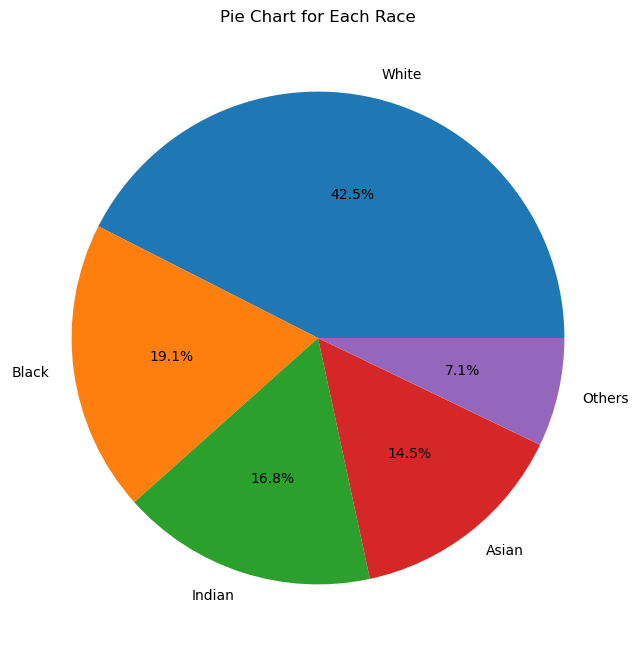

In [5]:
race_dict = {
    0: 'White', 
    1: 'Black', 
    2: 'Asian', 
    3: 'Indian', 
    4: 'Others'
}

plot_pie(df['race'], race_dict, "Pie Chart for Each Race")

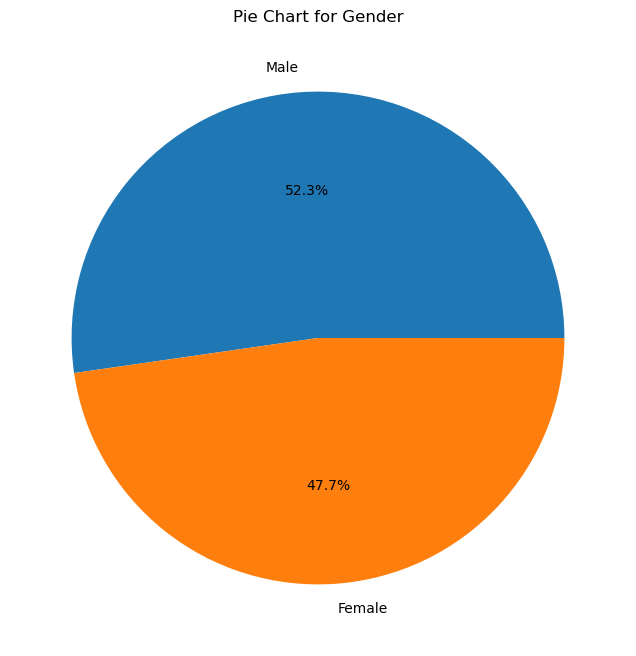

In [63]:
gender_dict = {
    0: 'Male',
    1: 'Female'
}

plot_pie(df['gender'], gender_dict, "Pie Chart for Gender")

[Text(0.5, 1.0, 'Age Distribution'),
 Text(0.5, 0, 'Age'),
 Text(0, 0.5, 'Count')]

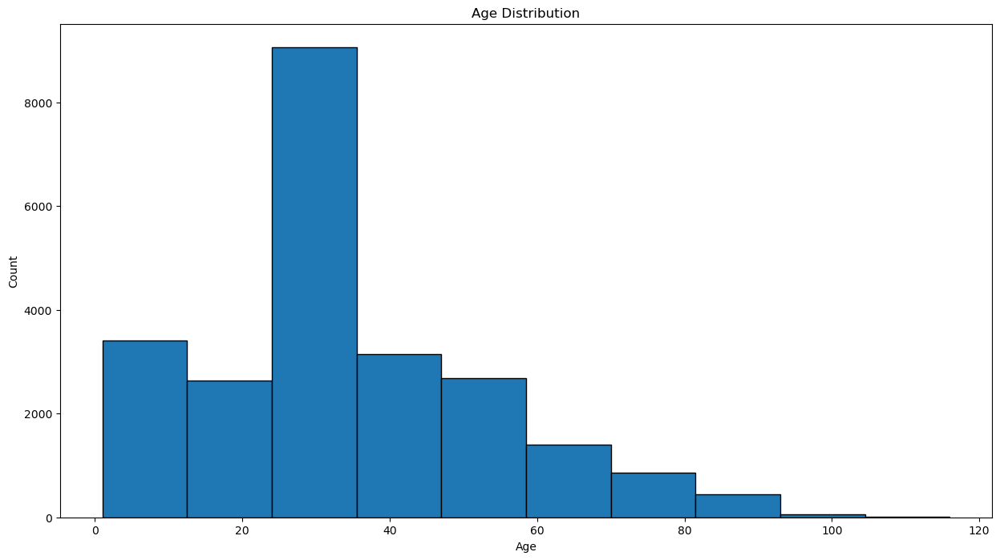

In [18]:
df['age'].plot.hist(edgecolor = 'black').set(title = 'Age Distribution', 
                                             xlabel='Age', 
                                             ylabel = 'Count')

In [10]:
# df.groupby(['age', 'gender']).size()
ranges = [0,10,20,30,40,50,60,70,80,90,100,110,120]
df['age'].value_counts(bins = ranges, sort = False)

(-0.001, 10.0]    3218
(10.0, 20.0]      1659
(20.0, 30.0]      7784
(30.0, 40.0]      4338
(40.0, 50.0]      2100
(50.0, 60.0]      2211
(60.0, 70.0]      1170
(70.0, 80.0]       685
(80.0, 90.0]       453
(90.0, 100.0]       66
(100.0, 110.0]      13
(110.0, 120.0]       8
Name: age, dtype: int64

In [21]:
df_2 = df.copy()
df_2['range'] = pd.cut(df_2['age'], ranges)
df_2.groupby(['range', 'gender'])['image'].count()

range       gender
(0, 10]     0         1538
            1         1680
(10, 20]    0          689
            1          970
(20, 30]    0         3310
            1         4474
(30, 40]    0         2476
            1         1862
(40, 50]    0         1456
            1          644
(50, 60]    0         1541
            1          670
(60, 70]    0          776
            1          394
(70, 80]    0          422
            1          263
(80, 90]    0          171
            1          282
(90, 100]   0            7
            1           59
(100, 110]  0            5
            1            8
(110, 120]  0            0
            1            8
Name: image, dtype: int64

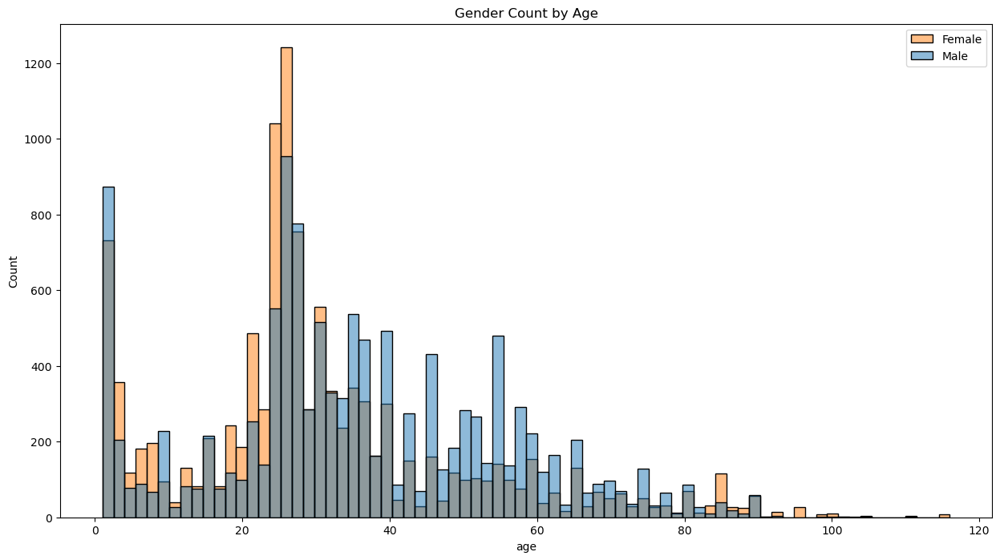

In [48]:
sns.histplot(x='age', hue='gender', data=df)
plt.title('Gender Count by Age')
plt.legend(labels=['Female', 'Male'])
plt.show()

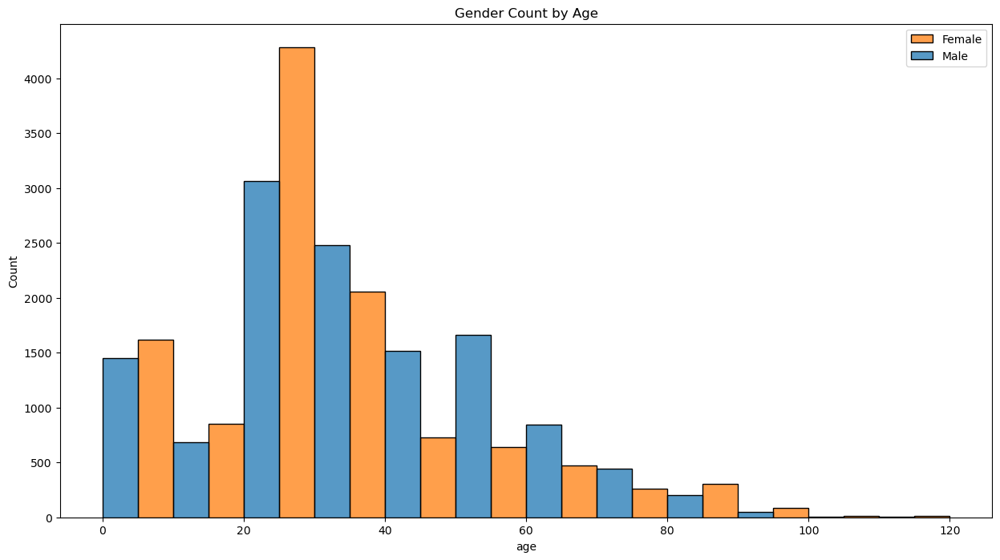

In [51]:
sns.histplot(x='age', hue='gender', data=df, bins = ranges, multiple="dodge")
plt.title('Gender Count by Age')
plt.legend(labels=['Female', 'Male'])
plt.show()

In [4]:
# To get the image from the range I want.
# White = 0 
# Black =1 
# Asian = 2
# Indian = 3
# Others(e.g: Hispanic, Latino, Middle Eastern) = 4
race = 0 
gender = 1 # Female = 1, Male = 0
age_min = 20
age_max = 35

data = df[(df['race']==race)
          #&(df['gender'] == gender) 
          &(df['age'] >= age_min ) 
          &(df['age'] <= age_max)]

# Will randomize the dataframe for later split in test and validation file.
data = data.sample(frac = 1, random_state = 0)
# Adding the index for easier access to every row to get the path.
data = data.reset_index()
data

,index,image,gender,age,race
0,5870,UTKface\26_0_0_20170117114657664.jpg.chip.jpg,0,26,0
1,5098,UTKface\25_0_0_20170119171125583.jpg.chip.jpg,0,25,0
2,4200,UTKface\24_0_0_20170117194602044.jpg.chip.jpg,0,24,0
3,4414,UTKface\24_1_0_20170104015931173.jpg.chip.jpg,1,24,0
4,3727,UTKface\23_0_0_20170116221722978.jpg.chip.jpg,0,23,0
...,...,...,...,...,...
3185,5337,UTKface\25_1_0_20170116213524092.jpg.chip.jpg,1,25,0
3186,5409,UTKface\25_1_0_20170117204147750.jpg.chip.jpg,1,25,0
3187,8653,UTKface\28_0_0_20170117191934140.jpg.chip.jpg,0,28,0
3188,12254,UTKface\33_0_0_20170105164910285.jpg.chip.jpg,0,33,0


From the output above, we able to know that there is 3190 images total are fitted for the model below for training and testing.

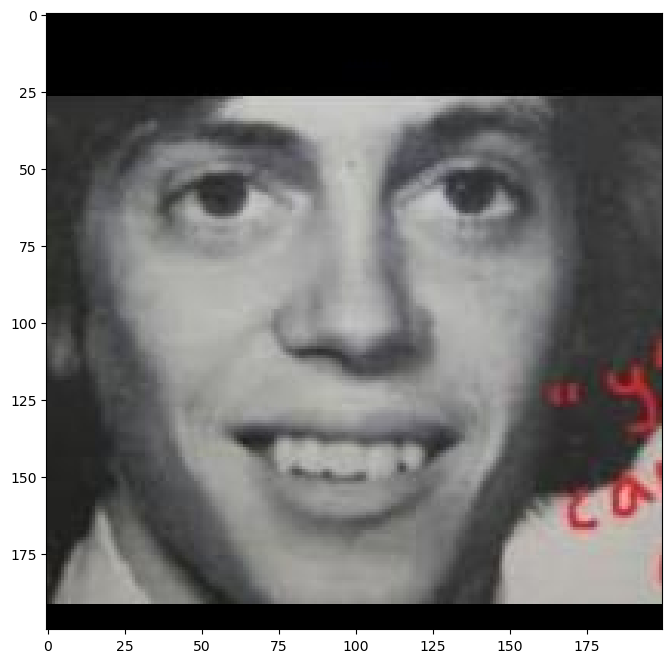

In [5]:
# Before moving to next part, I wanted to make sure that the image path is able to work.
im = Image.open(data.iloc[0,1]) # random picking one picture.
plt.imshow(im)
plt.show()

[Text(0, 0.5, 'Count'),
 Text(0.5, 0, 'Age'),
 Text(0.5, 1.0, 'Age Distribution')]

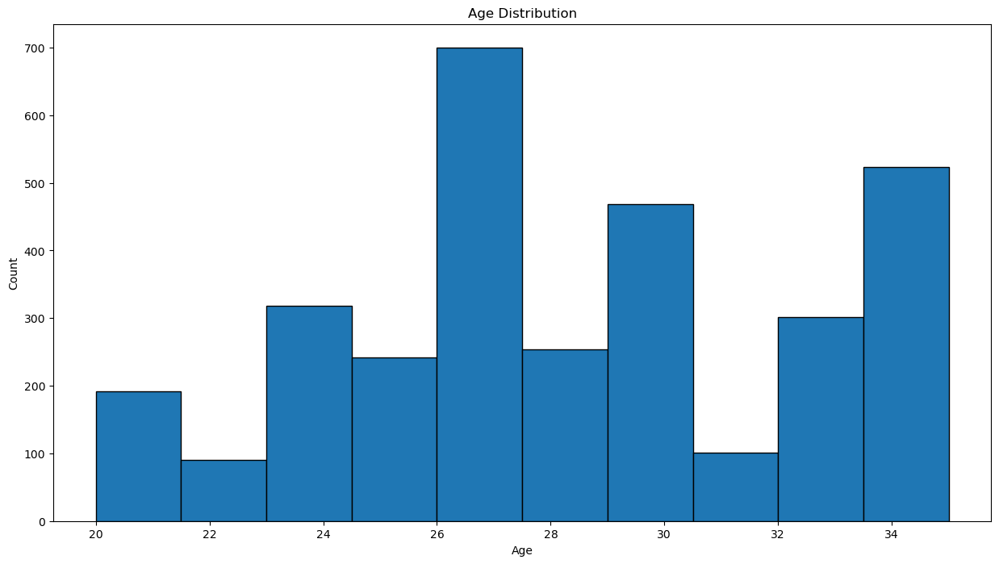

In [6]:
data['age'].plot.hist(edgecolor = 'black').set(title = 'Age Distribution', 
                                             xlabel='Age', 
                                             ylabel = 'Count')

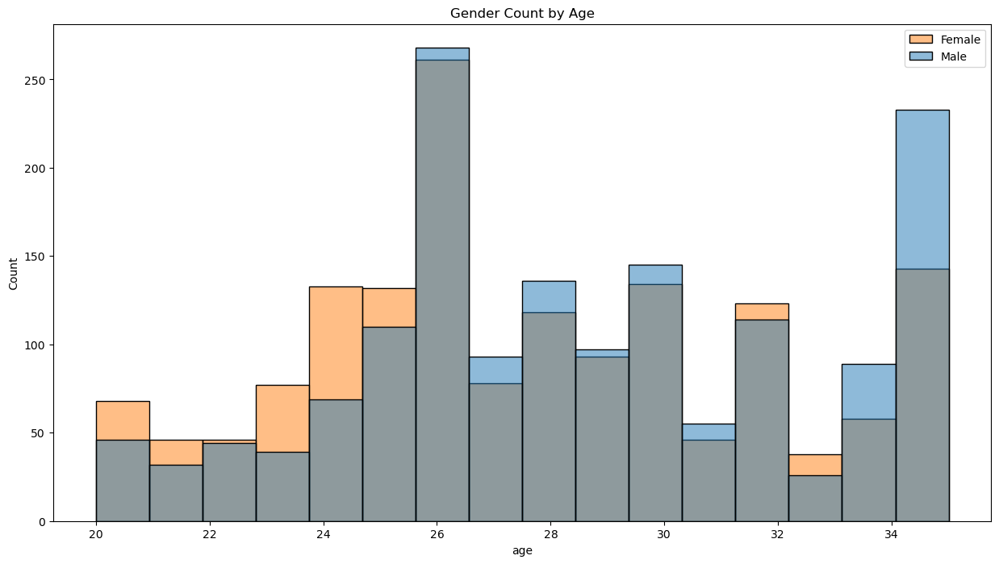

In [7]:
sns.histplot(x='age', hue='gender', data=data)
plt.title('Gender Count by Age')
plt.legend(labels=['Female', 'Male'])
plt.show()

In [8]:
# check how many female and male in each folder.
print(data['gender'].value_counts())

gender
0    1596
1    1594
Name: count, dtype: int64


From the graph and output above, we able to know that the images for each gender is fairly equal which both gender has almost 1600 pictures. This will help to prevent that the model might be trained bias. 

In [10]:
# Creating folder for batch processing
import shutil
import os

subfolder_names = ['class0', 'class1']
for subfolder_name in subfolder_names:
    os.makedirs(os.path.join('test', subfolder_name))

for subfolder_name in subfolder_names:
    os.makedirs(os.path.join('validate', subfolder_name))

cwd = os.getcwd()

# Copy image into the folder for class 0 and class 1 by gender.
# I keep 25 image for each gender for validate folder. 
path_test_0 = cwd + "\\test\class0"
path_test_1 = cwd + "\\test\class1"
path_validate_0 = cwd + "\\validate\class0"
path_validate_1 = cwd + "\\validate\class1"

# I get the total from above output.
# This is to helping me to seperate the test and validation file.
count_f = 1594
count_m = 1596
for index, row in data.iterrows():
    if row['gender'] == 0: # Class 0 (Male)
        if(count_m <= 300): # Last 300 picture for validate purpose
            shutil.copy((row['image']), path_validate_0)
        else:
            shutil.copy((row['image']), path_test_0)    
        count_m = count_m -1
    if row['gender'] == 1: # Class 1 (Female)
        if(count_f <= 300): # Last 300 picture for validate purpose
            shutil.copy((row['image']), path_validate_1)
        else:
            shutil.copy((row['image']), path_test_1)  
        count_f = count_f -1

Since we already make sure that the path is working and we already filter out the images that fitted in the range we needed, we can put them into the X and Y list for further processing.

In [11]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

# set the width and height
w, h = 64, 64
X, Y = [], []

for index, row in data.iterrows():
    im = Image.open(row['image']).convert('L')
    im = im.resize((w, h), Image.ANTIALIAS) # Resize the images
    arr = np.array(im) # Convert to numpy array

    # Add images to the lists and class
    X.append(arr)
    Y.append(row['gender'])

X = np.array(X) # Convert to NP array
X = X.reshape(X.shape[0], w, h, 1 ).astype('float32')
X = X / 255 # Normalize the data

Y = np.array(Y)
# randomize the data set - numpy arrays
randomize = np.arange(len(X))
np.random.shuffle(randomize)
X = X[randomize]
Y = Y[randomize]

Y = to_categorical(Y)
num_classes = Y.shape[1]

#### Batch processing

In [7]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

w, h = 64, 64

# create a data generator
datagen = ImageDataGenerator(
        samplewise_center=True,  
        rotation_range=15,   
        zoom_range = 0.1, 
        width_shift_range=0.1,  
        height_shift_range=0.1,  
        horizontal_flip=True, 
        vertical_flip=False,
        fill_mode = 'nearest')

# load and iterate training dataset
train_batch_processing = datagen.flow_from_directory('test/', 
                                       target_size=(w, h), 
                                       color_mode='grayscale', 
                                       class_mode='categorical', 
                                       batch_size=32)

# load and iterate validation dataset
valid_batch_processing = datagen.flow_from_directory('validate/', 
                                      target_size=(w, h), 
                                      color_mode='grayscale', 
                                      class_mode='categorical', 
                                      batch_size=32)

Found 2590 images belonging to 2 classes.
Found 600 images belonging to 2 classes.


The parameters for the ImageDataGenarator: 
- <span style="color:red">rotation_range</span>: Randomly rotates the image by a maximum of 15 degrees. This introduces slight variations in head orientations.
- <span style="color:red">width_shift_range and height_shift_range</span>: Randomly shifts the image horizontally and vertically by a maximum of 10% of the image size. This can simulate slight changes in facial position within the image.
- <span style="color:red">zoom_range</span>: Randomly zooms the image by a maximum of 0.1, providing slight variations in facial scale.
- <span style="color:red">horizontal_flip</span>: Allows horizontal flips, creating mirror-like transformations.
- <span style="color:red">fill_mode</span>: Uses the 'nearest' mode to fill newly created pixels after transformations, avoiding unrealistic artifacts.


The batch size: <span style="color:red">32</span>

The width and height: <span style="color:red">64 * 64 (resize)</span>

The image color: <span style="color:red">Grayscale</span>

### Model exploration to determine network topology (convolutional layers and dense layers)
- 4 network were explored

In [8]:
# Define function for plotting graph after training the model.
def plotting(history):
    plt.subplot(1,2,1)
    plt.plot(history.history['acc'])
    plt.plot(history.history['val_acc'])
    plt.title('Model Accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper right')

    plt.subplot(1,2,2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'test'], loc='upper right')
    plt.show()  

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/10
81/81 [==============================] - 27s 332ms/step - loss: 18.6873 - acc: 0.4938 - val_loss: 0.6931 - val_acc: 0.5033
Epoch 2/10
81/81 [==============================] - 6s 72ms/step - loss: 0.6930 - acc: 0.5000 - val_loss: 0.6931 - val_acc: 0.5033
Epoch 3/10
81/81 [==============================] - 6s 70ms/step - loss: 0.6932 - acc: 0.4996 - val_loss: 0.7024 - val_acc: 0.5033
Epoch 4/10
81/81 [==============================] - 6s 71ms/step - loss: 0.6933 - acc: 0.4915 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 5/10
81/81 [==============================] - 6s 70ms/step - loss: 0.6932 - acc: 0.5004 - val_loss: 0.6935 - val_acc: 0.4967
Epoch 6/10
81/81 [==============================] - 6s 70ms/step - loss: 0.6953 - acc: 0.4938 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 7/10
81/81 [==============================] - 6s 71ms/step - loss: 0.6932 - acc: 0.4965 - val_loss: 0.6931 - val_

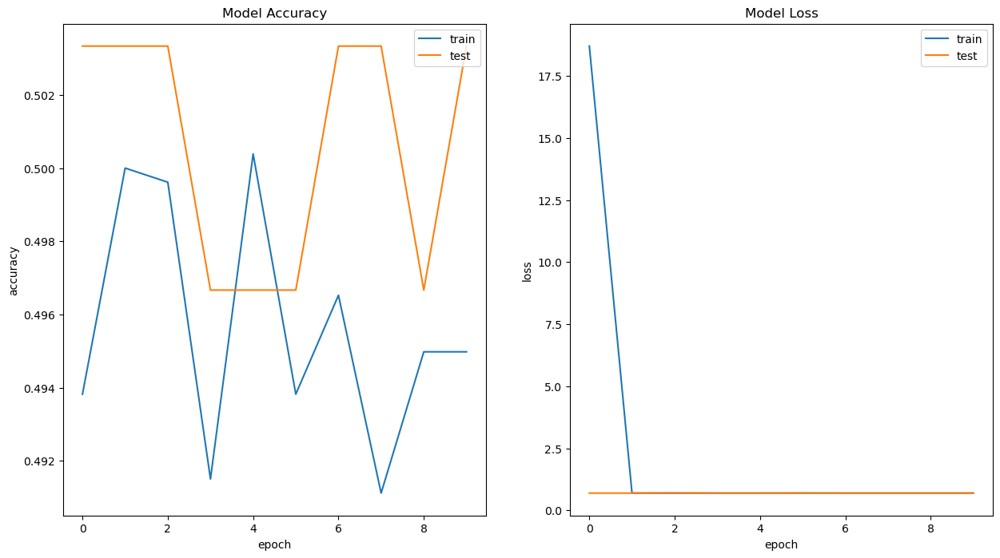

In [73]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model = Sequential()
model.add(Conv2D(32, (3, 3), strides=1, padding="valid", input_shape=(w, h,1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(2, activation='softmax'))

model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
history = model.fit(train_batch_processing, validation_data=valid_batch_processing, epochs=10, verbose=1)

plotting(history)

<span style = color:red>Model 1</span>

From the graph above, we able to notice that the accuracy is pretty bad and the model is slightly under fitting. I think we still able to do more on the Convolutional layer for better result. So maybe we can try to add more layer on next model.

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/10
81/81 [==============================] - 9s 106ms/step - loss: 5.7921 - acc: 0.6328 - val_loss: 0.5976 - val_acc: 0.6950
Epoch 2/10
81/81 [==============================] - 7s 81ms/step - loss: 0.5601 - acc: 0.7151 - val_loss: 0.5404 - val_acc: 0.7433
Epoch 3/10
81/81 [==============================] - 7s 82ms/step - loss: 0.5020 - acc: 0.7641 - val_loss: 0.4638 - val_acc: 0.7783
Epoch 4/10
81/81 [==============================] - 8s 96ms/step - loss: 0.4748 - acc: 0.7846 - val_loss: 0.5069 - val_acc: 0.7683
Epoch 5/10
81/81 [==============================] - 9s 107ms/step - loss: 0.4276 - acc: 0.8127 - val_loss: 0.4204 - val_acc: 0.8383
Epoch 6/10
81/81 [==============================] - 8s 94ms/step - loss: 0.3941 - acc: 0.8363 - val_loss: 0.3522 - val_acc: 0.8617
Epoch 7/10
81/81 [==============================] - 7s 83ms/step - loss: 0.3973 - acc: 0.8255 - val_loss: 0.3475 - val_a

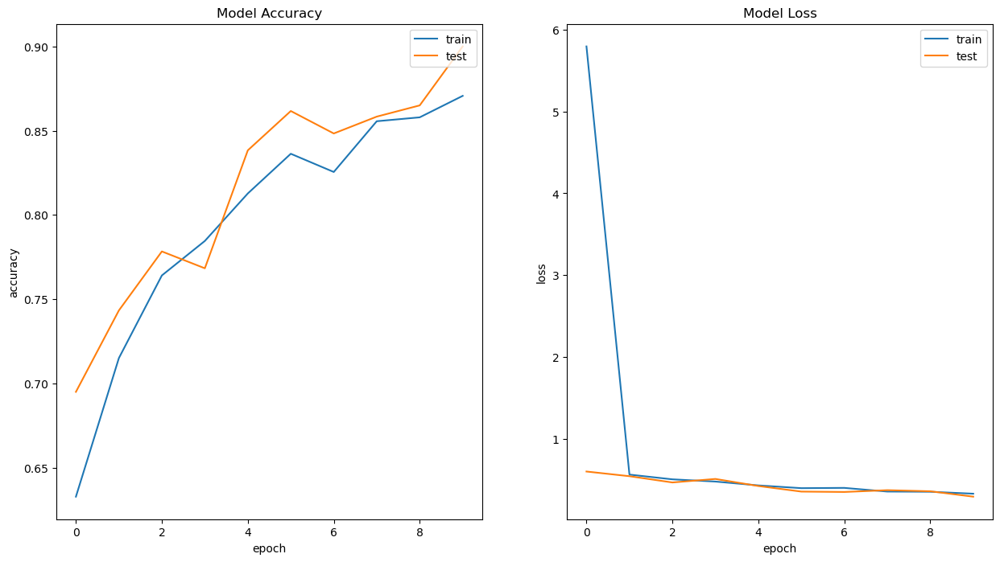

In [74]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model2 = Sequential()
model2.add(Conv2D(32, (3, 3), strides=1, padding="valid", input_shape=(w, h,1), activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model2.add(Conv2D(64, (3, 3), strides=1, padding="valid", activation='relu'))
model2.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))

model2.add(Flatten())
model2.add(Dense(128, activation='relu'))
model2.add(Dense(2, activation='softmax'))

model2.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
history = model2.fit(train_batch_processing, validation_data=valid_batch_processing, epochs=10, verbose=1)

plotting(history)

<span style = color:red>Model 2</span>

From the graph above, we know that adding Convolutional layer actually give better result. The accuracy have improve from 50% to almost 90% compare to the first model. Maybe we can discover what will happen if we adding 1 more Convolutional layer on the next model.

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/10
81/81 [==============================] - 7s 88ms/step - loss: 2.1796 - acc: 0.6390 - val_loss: 0.5472 - val_acc: 0.7300
Epoch 2/10
81/81 [==============================] - 6s 70ms/step - loss: 0.5298 - acc: 0.7444 - val_loss: 0.4463 - val_acc: 0.8167
Epoch 3/10
81/81 [==============================] - 9s 106ms/step - loss: 0.4289 - acc: 0.8093 - val_loss: 0.3667 - val_acc: 0.8533
Epoch 4/10
81/81 [==============================] - 7s 82ms/step - loss: 0.3799 - acc: 0.8297 - val_loss: 0.3250 - val_acc: 0.8767
Epoch 5/10
81/81 [==============================] - 8s 97ms/step - loss: 0.3459 - acc: 0.8475 - val_loss: 0.3468 - val_acc: 0.8500
Epoch 6/10
81/81 [==============================] - 8s 99ms/step - loss: 0.3206 - acc: 0.8649 - val_loss: 0.2755 - val_acc: 0.8950
Epoch 7/10
81/81 [==============================] - 8s 98ms/step - loss: 0.2891 - acc: 0.8838 - val_loss: 0.2809 - val_ac

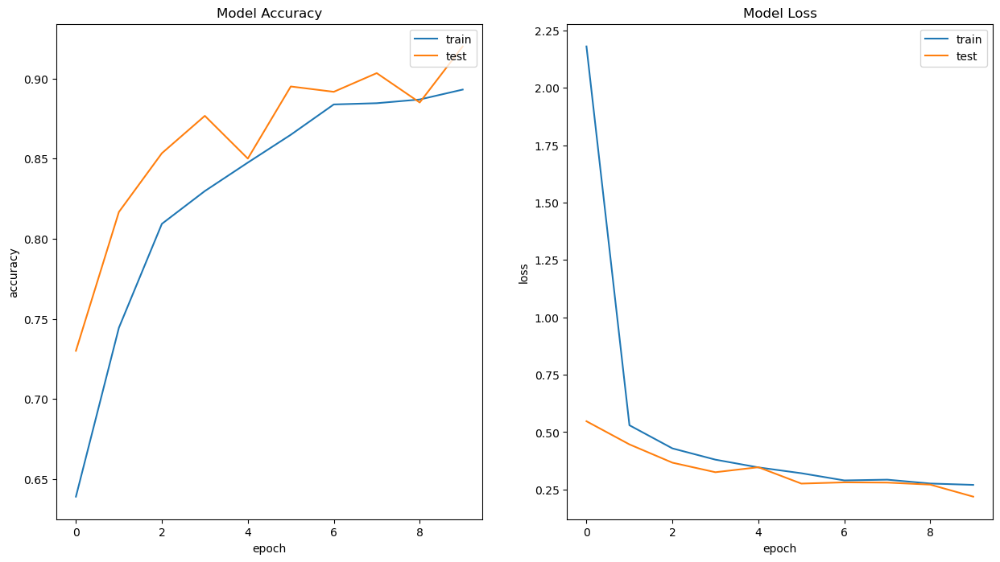

In [75]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model3 = Sequential()
model3.add(Conv2D(32, (3, 3), activation='relu', strides=1, padding="valid", input_shape=(w, h,1)))
model3.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model3.add(Conv2D(64, (3, 3), strides=1, padding="valid", activation='relu'))
model3.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model3.add(Conv2D(128, (3, 3), strides=1, padding="valid", activation='relu'))
model3.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model3.add(Flatten())
model3.add(Dense(128, activation='relu'))
model3.add(Dense(2, activation='softmax'))

model3.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
history = model3.fit(train_batch_processing, validation_data=valid_batch_processing, epochs=10, verbose=1)

plotting(history)

<span style = color:red>Model 3</span>

From the graph above, we able to notice that the accuracy compare with first 2 model is way better, it even above 90% for the test set. However, the model might have a chance happen slightly overfitting. Top revent that, maybe we can use 'Dropout' function or larger dense layer to avoid overfitting.

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/15
81/81 [==============================] - 11s 137ms/step - loss: 1.4885 - acc: 0.6548 - val_loss: 0.5181 - val_acc: 0.7750
Epoch 2/15
81/81 [==============================] - 6s 77ms/step - loss: 0.5195 - acc: 0.7533 - val_loss: 0.4368 - val_acc: 0.8067
Epoch 3/15
81/81 [==============================] - 6s 79ms/step - loss: 0.4430 - acc: 0.8066 - val_loss: 0.3643 - val_acc: 0.8467
Epoch 4/15
81/81 [==============================] - 6s 78ms/step - loss: 0.3738 - acc: 0.8336 - val_loss: 0.3210 - val_acc: 0.8883
Epoch 5/15
81/81 [==============================] - 6s 79ms/step - loss: 0.3357 - acc: 0.8602 - val_loss: 0.3250 - val_acc: 0.8833
Epoch 6/15
81/81 [==============================] - 6s 79ms/step - loss: 0.3233 - acc: 0.8683 - val_loss: 0.2976 - val_acc: 0.8850
Epoch 7/15
81/81 [==============================] - 7s 83ms/step - loss: 0.2918 - acc: 0.8826 - val_loss: 0.2700 - val_a

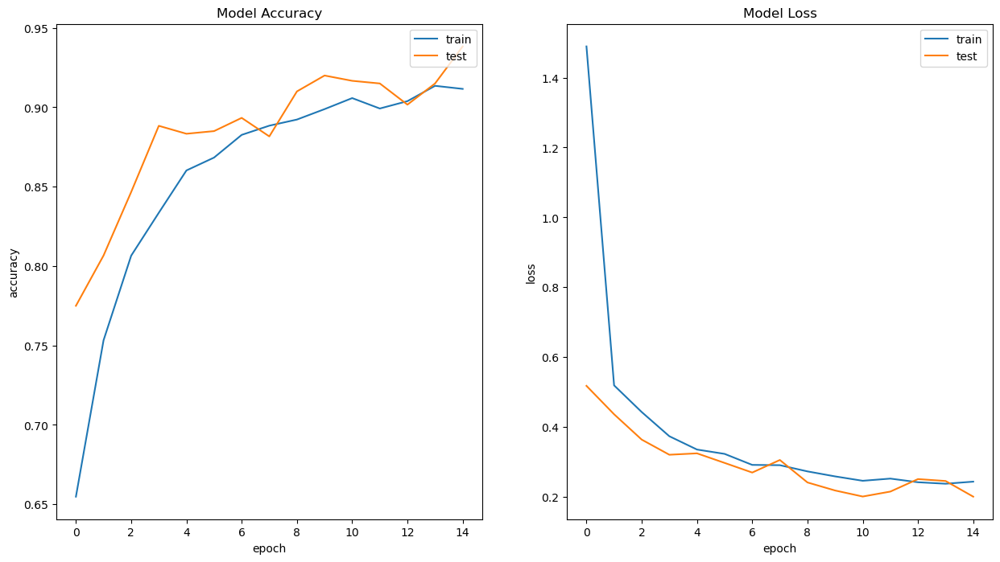

In [14]:
from tensorflow.keras.layers import Dropout

seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model4 = Sequential()
model4.add(Conv2D(32, (3, 3), strides=1, padding="valid", input_shape=(w, h,1), activation='relu'))
model4.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model4.add(Conv2D(64, (3, 3), strides=1, padding="valid", activation='relu'))
model4.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model4.add(Conv2D(128, (3, 3), strides=1, padding="valid", activation='relu'))
model4.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model4.add(Flatten())
model4.add(Dense(128, activation='relu'))
model4.add(Dropout(0.2))
model4.add(Dense(2, activation='softmax'))

model4.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
history = model4.fit(train_batch_processing, validation_data=valid_batch_processing, epochs=15, verbose=1)

plotting(history)

<span style = color:red>Model 4</span>

From the graph above, we able to notice that the model 4 after adding 'Dropout' function have a better test result. The loss curve show that it is even better than model 3. But this is not the only way to prevent overfitting in a model. Maybe we can try to incresase the dense layer and see will the result better than 'Dropout' function.

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/15
81/81 [==============================] - 9s 116ms/step - loss: 2.6883 - acc: 0.6718 - val_loss: 0.5128 - val_acc: 0.7550
Epoch 2/15
81/81 [==============================] - 8s 93ms/step - loss: 0.4892 - acc: 0.7691 - val_loss: 0.4298 - val_acc: 0.8033
Epoch 3/15
81/81 [==============================] - 8s 101ms/step - loss: 0.4123 - acc: 0.8201 - val_loss: 0.3834 - val_acc: 0.8500
Epoch 4/15
81/81 [==============================] - 7s 86ms/step - loss: 0.3741 - acc: 0.8340 - val_loss: 0.3964 - val_acc: 0.8350
Epoch 5/15
81/81 [==============================] - 7s 82ms/step - loss: 0.3740 - acc: 0.8425 - val_loss: 0.3113 - val_acc: 0.8800
Epoch 6/15
81/81 [==============================] - 7s 82ms/step - loss: 0.3140 - acc: 0.8710 - val_loss: 0.2878 - val_acc: 0.8850
Epoch 7/15
81/81 [==============================] - 7s 81ms/step - loss: 0.3047 - acc: 0.8641 - val_loss: 0.3023 - val_a

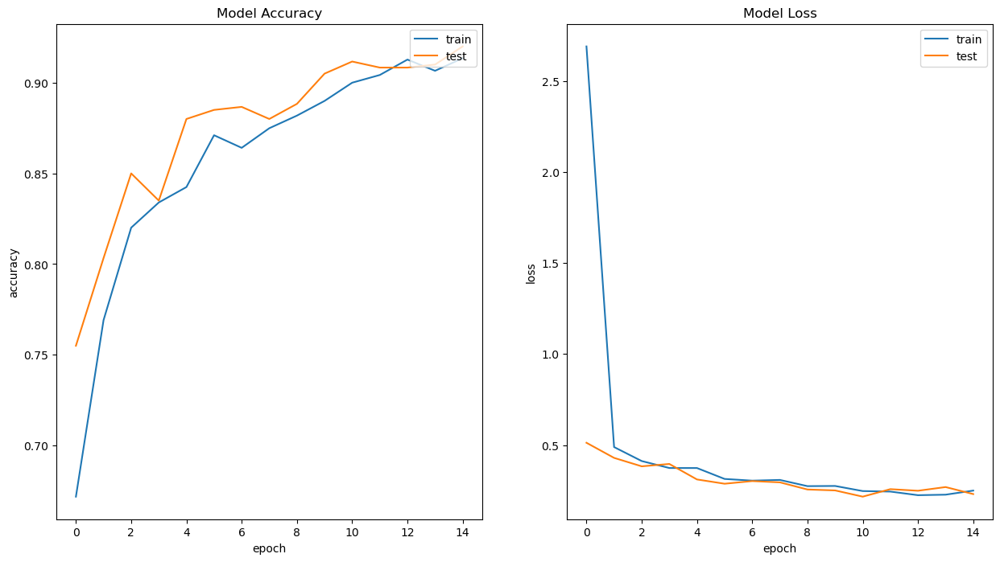

In [80]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

model5 = Sequential()
model5.add(Conv2D(32, (3, 3), strides=1, padding="valid", input_shape=(w, h,1), activation='relu'))
model5.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model5.add(Conv2D(64, (3, 3), strides=1, padding="valid", activation='relu'))
model5.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model5.add(Conv2D(128, (3, 3), strides=1, padding="valid", activation='relu'))
model5.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
model5.add(Flatten())
model5.add(Dense(256, activation='relu'))
model5.add(Dense(2, activation='softmax'))

model5.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
history = model5.fit(train_batch_processing, validation_data=valid_batch_processing, epochs=15, verbose=1)

plotting(history)

<span style = color:red>Model 5</span>

From the graph above, we know that the accuracy for train set is 90% and the test set is around 85% which is the best result so far compare to all previous model. The overfitting is not shown on the graph above which is great and we will use this model for further tuning.

### Hyperparameter investigation (kernel size only)  

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/15
81/81 [==============================] - 7s 83ms/step - loss: 2.6800 - acc: 0.6378 - val_loss: 0.5556 - val_acc: 0.7267
Epoch 2/15
81/81 [==============================] - 6s 72ms/step - loss: 0.5154 - acc: 0.7448 - val_loss: 0.4875 - val_acc: 0.7683
Epoch 3/15
81/81 [==============================] - 6s 71ms/step - loss: 0.4471 - acc: 0.7861 - val_loss: 0.3735 - val_acc: 0.8500
Epoch 4/15
81/81 [==============================] - 6s 72ms/step - loss: 0.4145 - acc: 0.8181 - val_loss: 0.3096 - val_acc: 0.8750
Epoch 5/15
81/81 [==============================] - 6s 72ms/step - loss: 0.3602 - acc: 0.8483 - val_loss: 0.3261 - val_acc: 0.8700
Epoch 6/15
81/81 [==============================] - 6s 71ms/step - loss: 0.3365 - acc: 0.8533 - val_loss: 0.2590 - val_acc: 0.9033
Epoch 7/15
81/81 [==============================] - 6s 71ms/step - loss: 0.3062 - acc: 0.8811 - val_loss: 0.3300 - val_acc

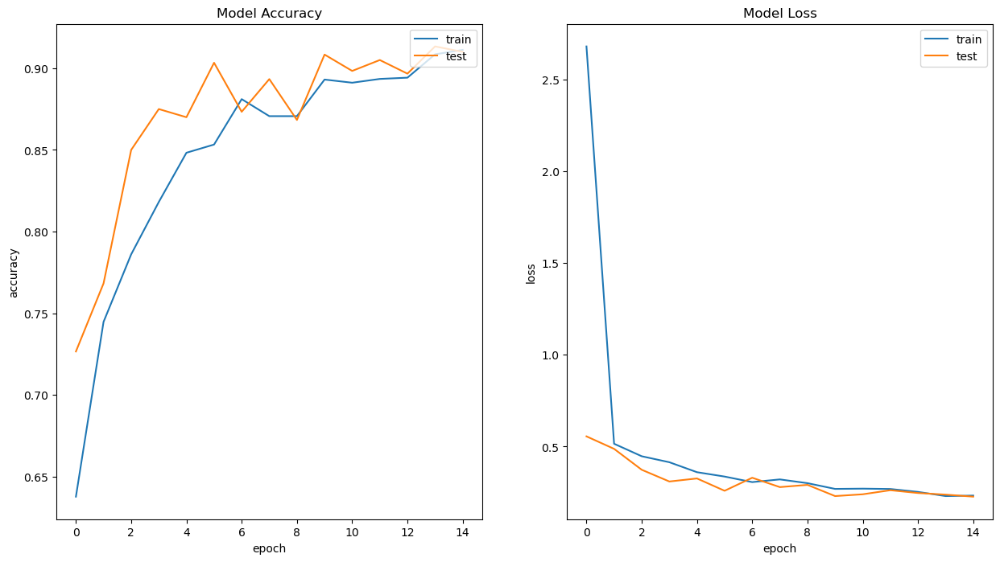

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/15
81/81 [==============================] - 7s 81ms/step - loss: 1.4120 - acc: 0.6066 - val_loss: 0.5610 - val_acc: 0.7117
Epoch 2/15
81/81 [==============================] - 6s 71ms/step - loss: 0.4960 - acc: 0.7583 - val_loss: 0.4354 - val_acc: 0.8050
Epoch 3/15
81/81 [==============================] - 6s 71ms/step - loss: 0.4011 - acc: 0.8251 - val_loss: 0.3689 - val_acc: 0.8450
Epoch 4/15
81/81 [==============================] - 6s 72ms/step - loss: 0.3488 - acc: 0.8579 - val_loss: 0.3329 - val_acc: 0.8600
Epoch 5/15
81/81 [==============================] - 6s 73ms/step - loss: 0.3298 - acc: 0.8737 - val_loss: 0.4032 - val_acc: 0.8250
Epoch 6/15
81/81 [==============================] - 6s 73ms/step - loss: 0.3256 - acc: 0.8645 - val_loss: 0.2798 - val_acc: 0.8983
Epoch 7/15
81/81 [==============================] - 6s 72ms/step - loss: 0.2911 - acc: 0.8830 - val_loss: 0.2901 - val_acc

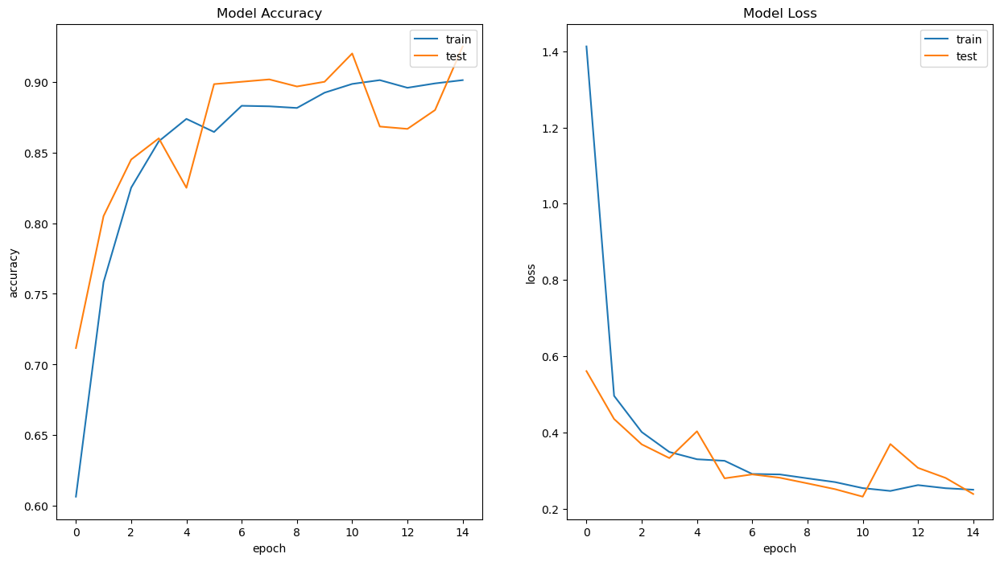

  ...
    to  
  ['...']
  ...
    to  
  ['...']
Train for 81 steps, validate for 19 steps
Epoch 1/15
81/81 [==============================] - 6s 80ms/step - loss: 1.4384 - acc: 0.4764 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 2/15
81/81 [==============================] - 6s 70ms/step - loss: 0.6933 - acc: 0.4865 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 3/15
81/81 [==============================] - 6s 72ms/step - loss: 0.6933 - acc: 0.4830 - val_loss: 0.6931 - val_acc: 0.5033
Epoch 4/15
81/81 [==============================] - 6s 71ms/step - loss: 0.6932 - acc: 0.4911 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 5/15
81/81 [==============================] - 7s 83ms/step - loss: 0.6933 - acc: 0.5004 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 6/15
81/81 [==============================] - 7s 82ms/step - loss: 0.6933 - acc: 0.4788 - val_loss: 0.6932 - val_acc: 0.4967
Epoch 7/15
81/81 [==============================] - 7s 82ms/step - loss: 0.6932 - acc: 0.4988 - val_loss: 0.6931 - val_acc

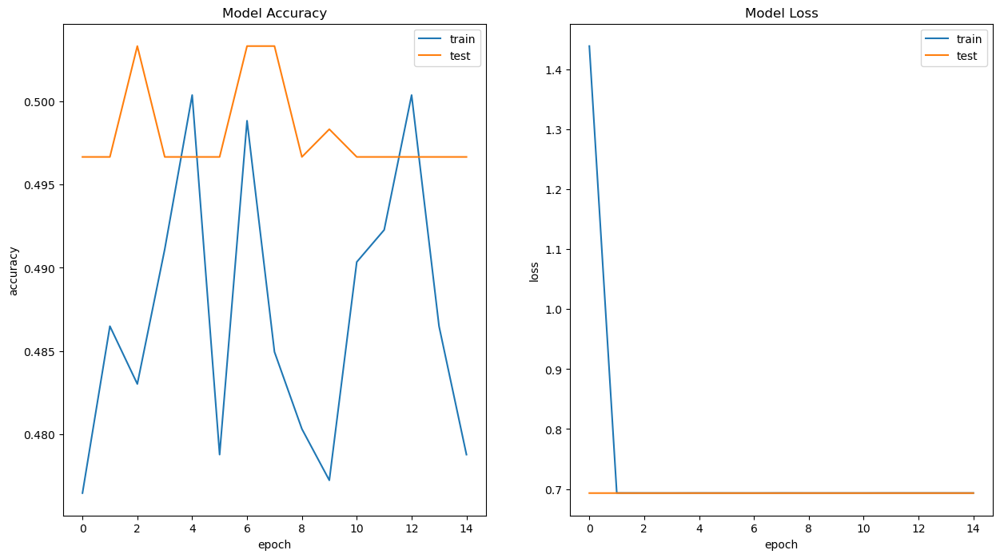

In [79]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

kernelSizes = [3,5,7]
for k in kernelSizes:
    modelk = Sequential()
    modelk.add(Conv2D(32, (k, k), strides=1, padding="valid", input_shape=(w, h,1), activation='relu'))
    modelk.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
    modelk.add(Conv2D(64, (k, k), strides=1, padding="valid", activation='relu'))
    modelk.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
    modelk.add(Conv2D(128, (k, k), strides=1, padding="valid", activation='relu'))
    modelk.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
    modelk.add(Flatten())
    modelk.add(Dense(256, activation='relu'))
    modelk.add(Dense(2, activation='softmax'))

    modelk.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
    history = modelk.fit(train_batch_processing, validation_data=valid_batch_processing, epochs=15, verbose=1)

    print("kernel Size:", k)
    plotting(history)

<span style = color:red>Kernel Size</span>

We have test with Kernel Size of 3, 5 and 7 which is consider as small, medium and large. From the graph above, we know that size 3 has the best overall result including train and test set which is around 90% and the loss curve also very smooth. Kernel size for 3 and 5 worked good on the train set but the loss for test set for size 5 is not good as size 3. For the kernel size 7, the train and test set is not working that well compare the other 2 

### Most appropriate model selection

- Convolution Layer: 3 (32, 64,128)
- Dense Layer: 256
- Kernel Size: 3
- Batch_size: 32
- image size (width & height): 64 * 64
- image color: grayscale
- loss: categorical_crossentropy
- epochs: 15

On the final model we no longer need to seperate the images into test and validate file. So we will use all the image for training the model.

Train on 3190 samples
Epoch 1/15
3190/3190 [==============================] - 3s 847us/sample - loss: 0.5620 - acc: 0.6931
Epoch 2/15
3190/3190 [==============================] - 2s 522us/sample - loss: 0.3281 - acc: 0.8627
Epoch 3/15
3190/3190 [==============================] - 2s 531us/sample - loss: 0.2434 - acc: 0.9091
Epoch 4/15
3190/3190 [==============================] - 2s 524us/sample - loss: 0.2109 - acc: 0.9219
Epoch 5/15
3190/3190 [==============================] - 2s 527us/sample - loss: 0.1795 - acc: 0.9354
Epoch 6/15
3190/3190 [==============================] - 2s 516us/sample - loss: 0.1581 - acc: 0.9489
Epoch 7/15
3190/3190 [==============================] - 2s 538us/sample - loss: 0.1296 - acc: 0.9580
Epoch 8/15
3190/3190 [==============================] - 2s 522us/sample - loss: 0.1169 - acc: 0.9649
Epoch 9/15
3190/3190 [==============================] - 2s 542us/sample - loss: 0.1129 - acc: 0.9655
Epoch 10/15
3190/3190 [==============================] - 2s 517us/sam

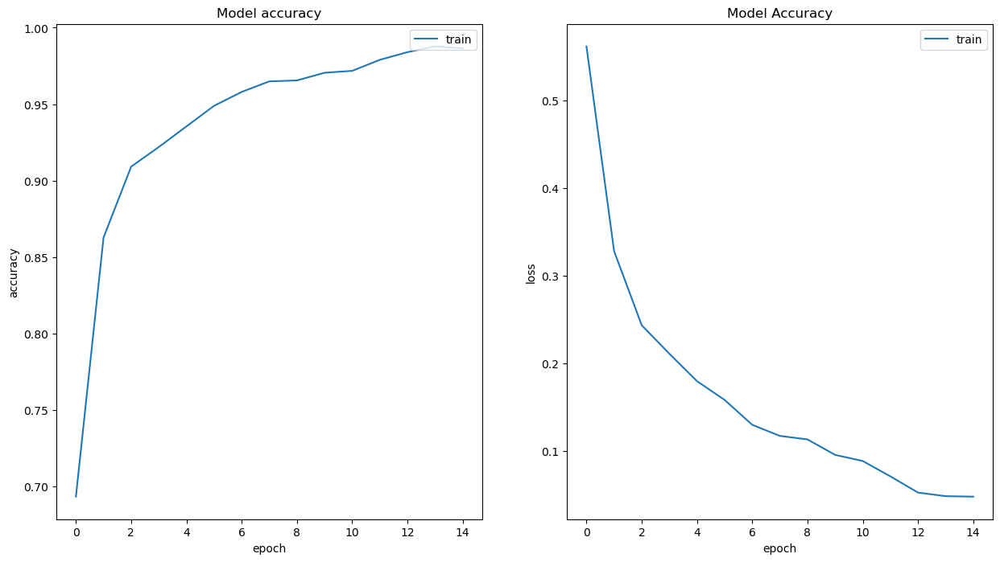

In [29]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

final_model = Sequential()
final_model.add(Conv2D(32, (3, 3), strides=1, padding="valid", input_shape=(64, 64, 1), activation='relu'))
final_model.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
final_model.add(Conv2D(64, (3, 3), strides=1, padding="valid", activation='relu'))
final_model.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
final_model.add(Conv2D(128, (3, 3), strides=1, padding="valid", activation='relu'))
final_model.add(MaxPooling2D(pool_size=(2, 2), padding="valid"))
final_model.add(Flatten())
final_model.add(Dense(256, activation='relu'))
final_model.add(Dense(2, activation='softmax'))

final_model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['acc'])
history = final_model.fit(X, Y, validation_split=0, epochs=15, batch_size=32, verbose=1)

plt.subplot(1,2,1)
plt.plot(history.history['acc'])
plt.title('Model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper right')

plt.subplot(1,2,2)
plt.plot(history.history['loss'])
plt.title('Model Accuracy')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train'], loc='upper right')
plt.show() 

In [110]:
final_model.summary()

Model: "sequential_16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_45 (Conv2D)           (None, 62, 62, 32)        320       
_________________________________________________________________
max_pooling2d_45 (MaxPooling (None, 31, 31, 32)        0         
_________________________________________________________________
conv2d_46 (Conv2D)           (None, 29, 29, 64)        18496     
_________________________________________________________________
max_pooling2d_46 (MaxPooling (None, 14, 14, 64)        0         
_________________________________________________________________
conv2d_47 (Conv2D)           (None, 12, 12, 128)       73856     
_________________________________________________________________
max_pooling2d_47 (MaxPooling (None, 6, 6, 128)         0         
_________________________________________________________________
flatten_16 (Flatten)         (None, 4608)            

### Analysis  of  performance  per  class  and  unseen  data  (10  per  class  including  saliency  maps  for unseen data) 

#### Predict for Unseen data

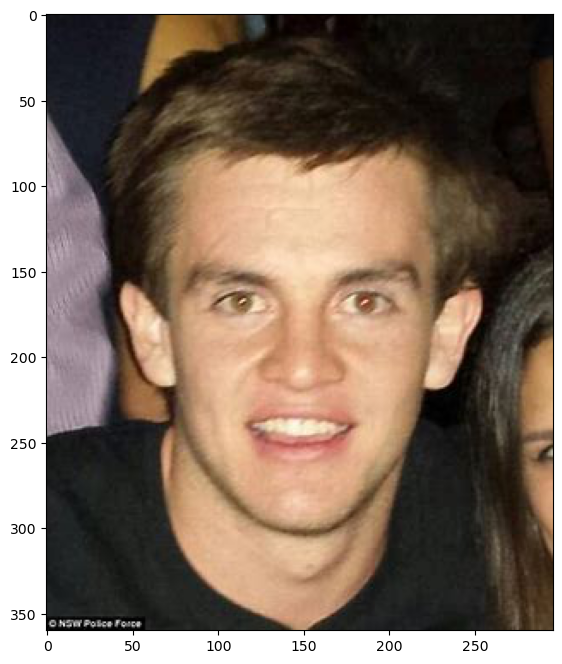

Predicted as: Male


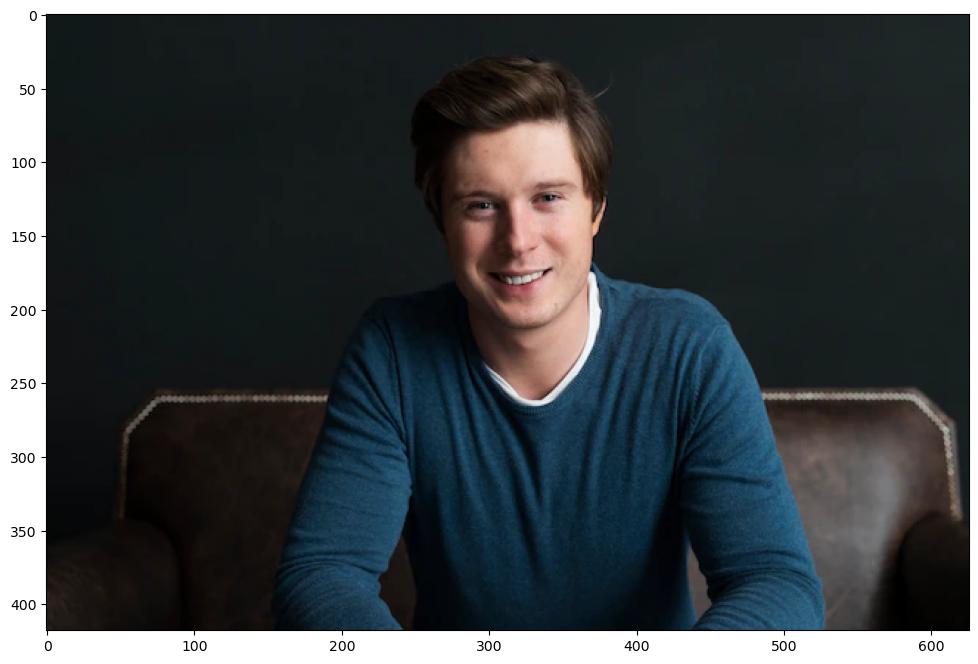

Predicted as: Male


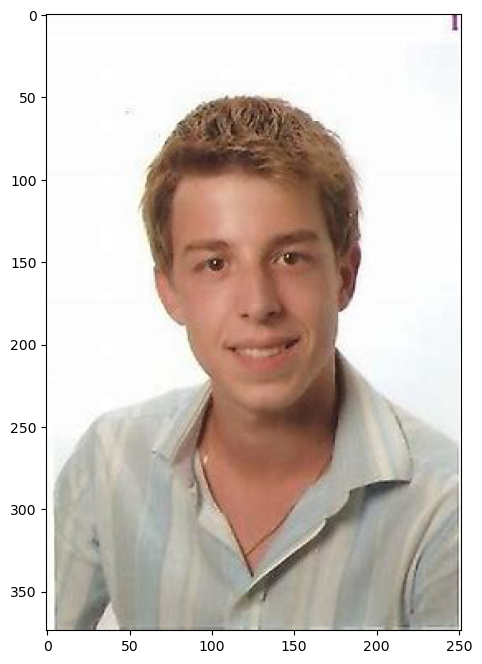

Predicted as: Male


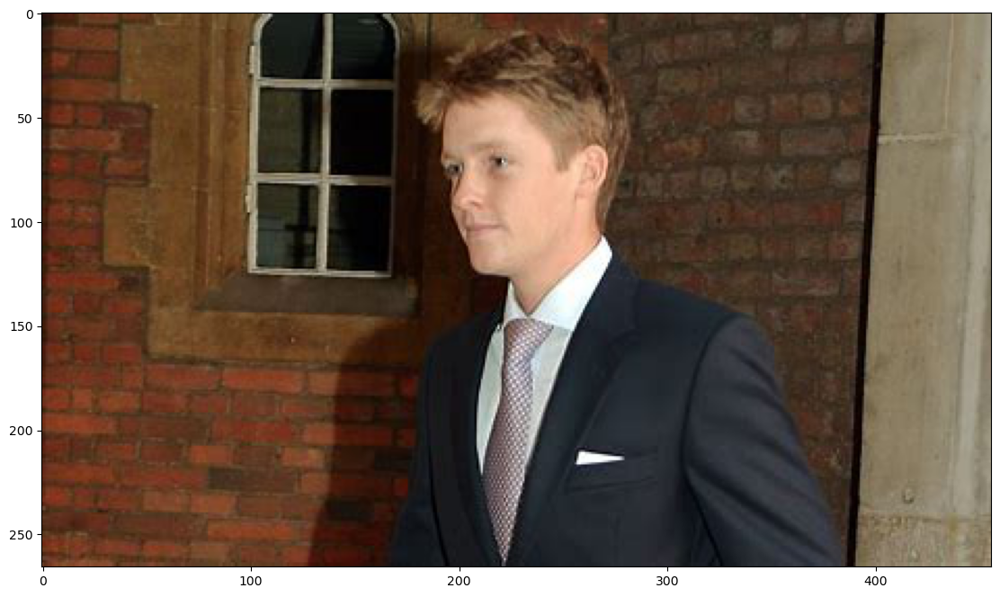

Predicted as: Male


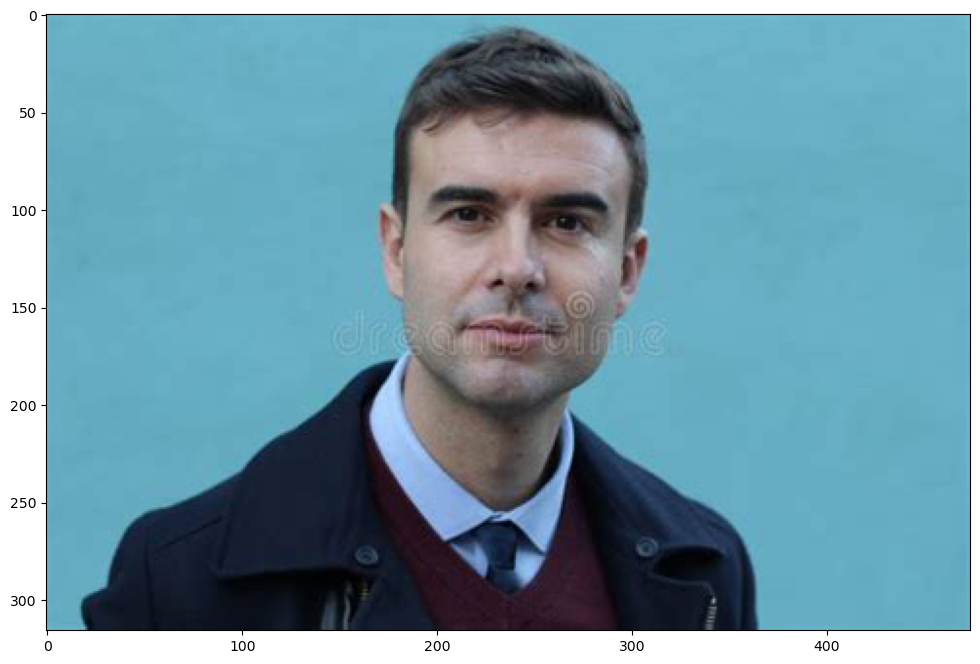

Predicted as: Male


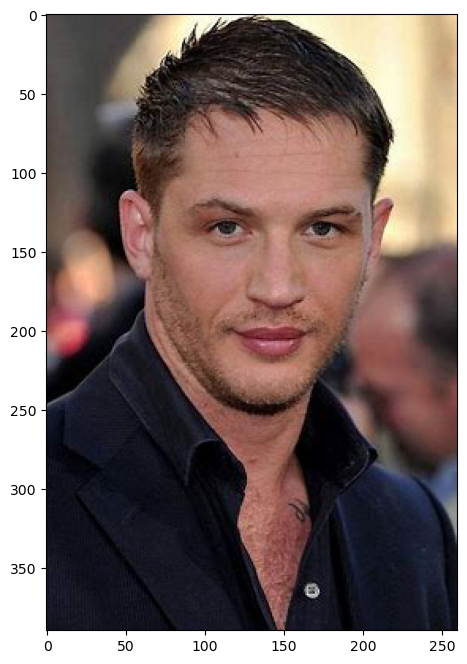

Predicted as: Female


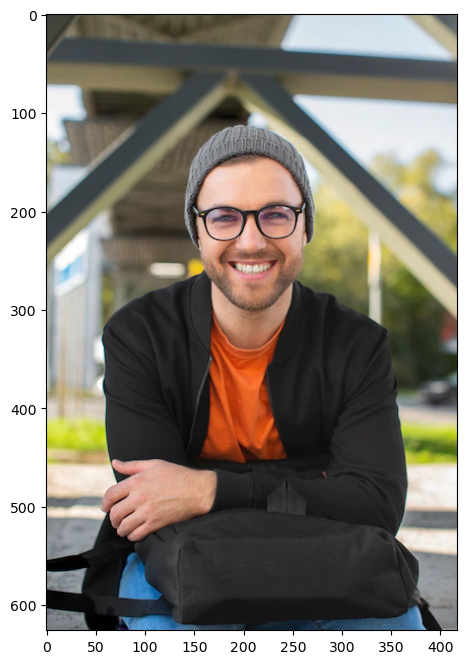

Predicted as: Male


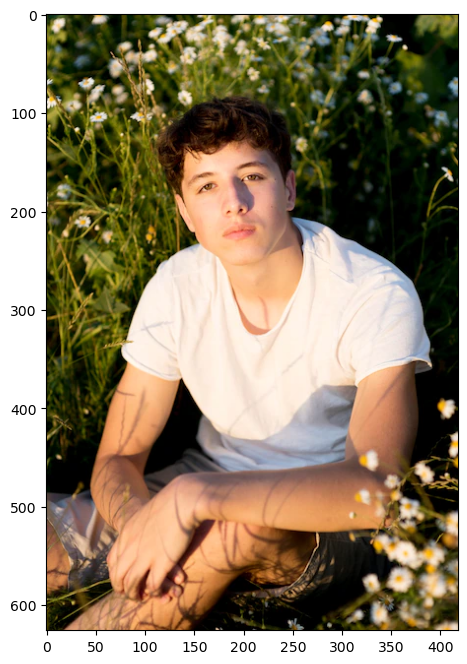

Predicted as: Female


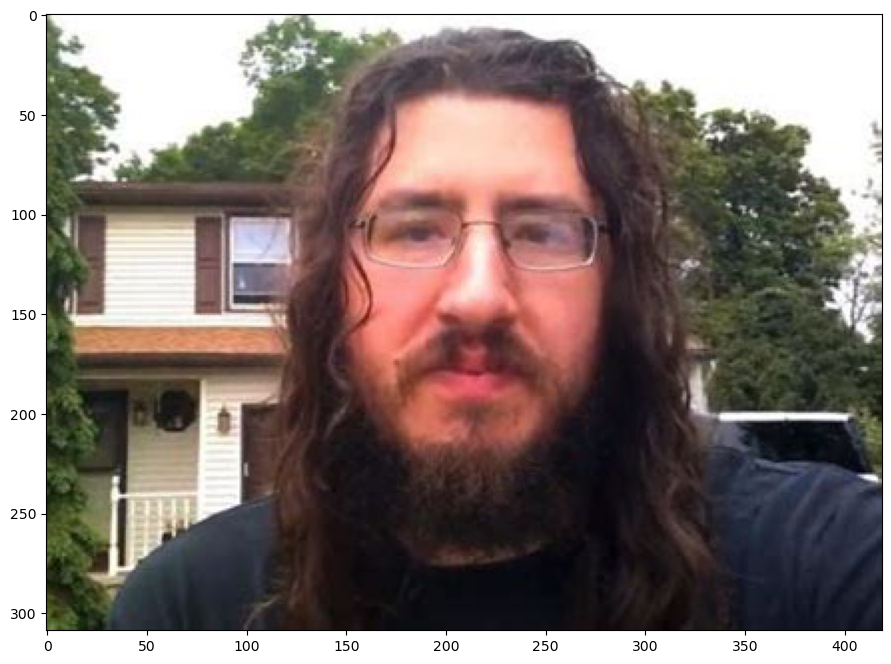

Predicted as: Male


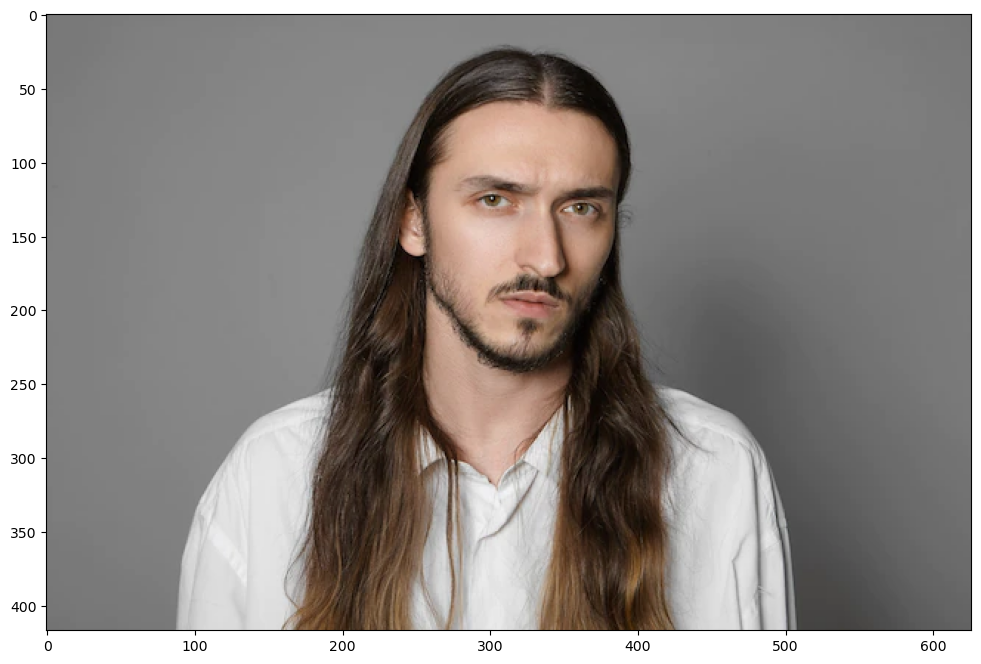

Predicted as: Male


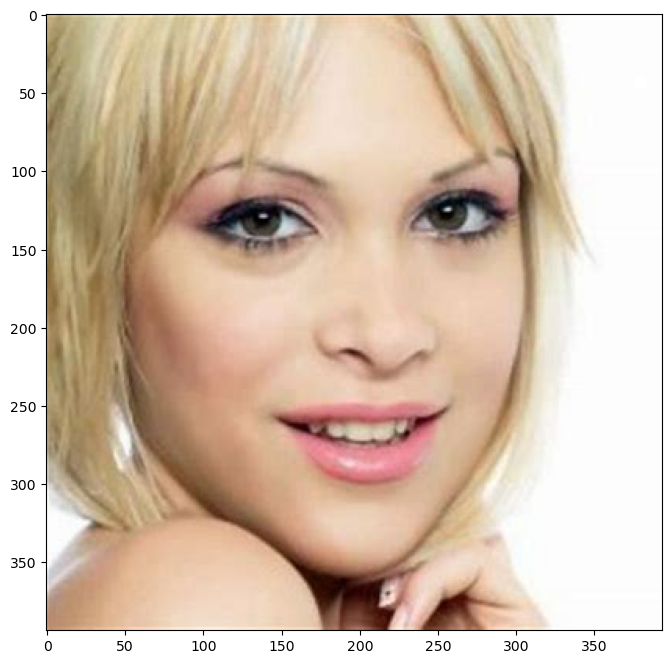

Predicted as: Female


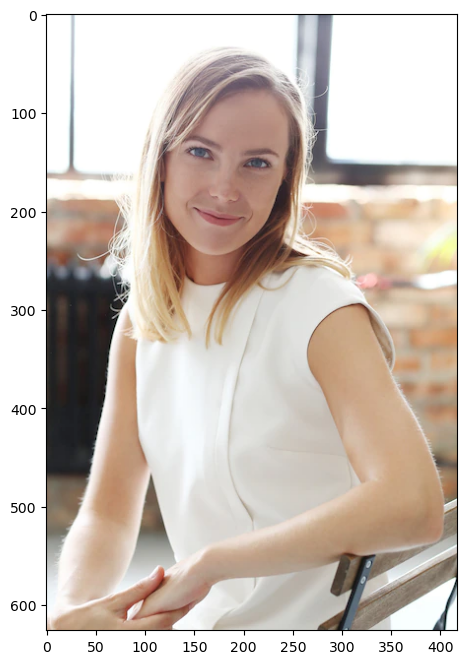

Predicted as: Female


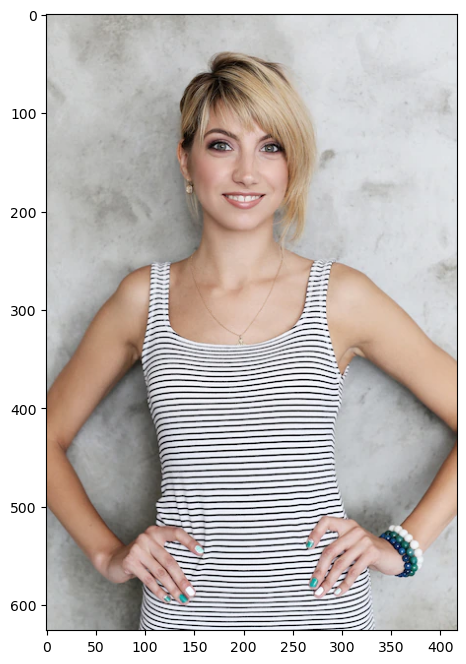

Predicted as: Female


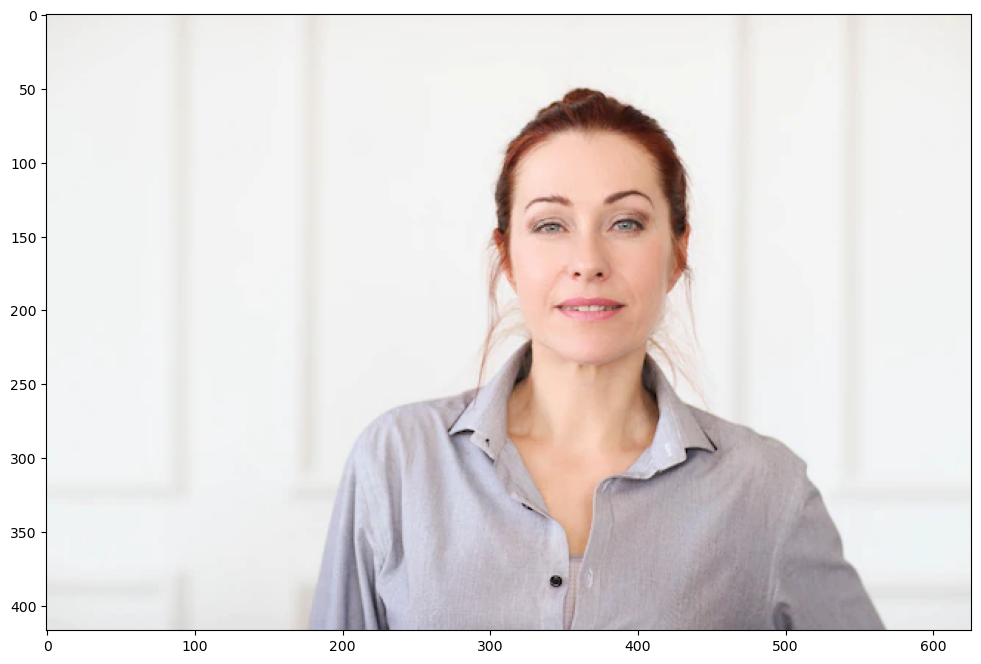

Predicted as: Male


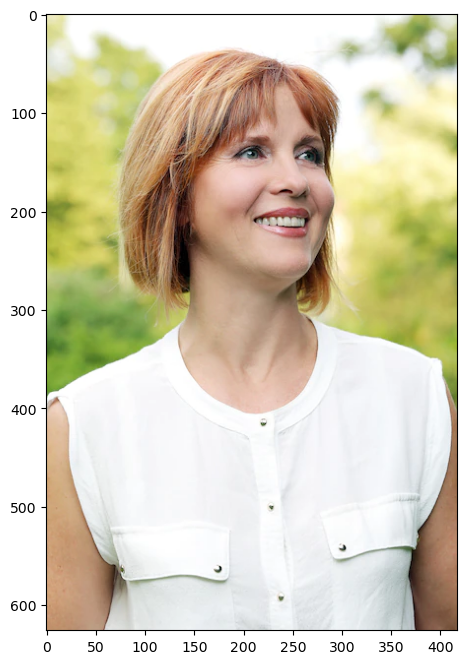

Predicted as: Female


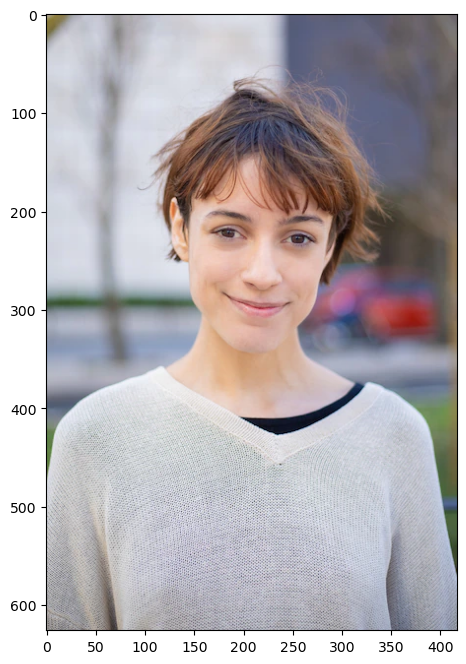

Predicted as: Female


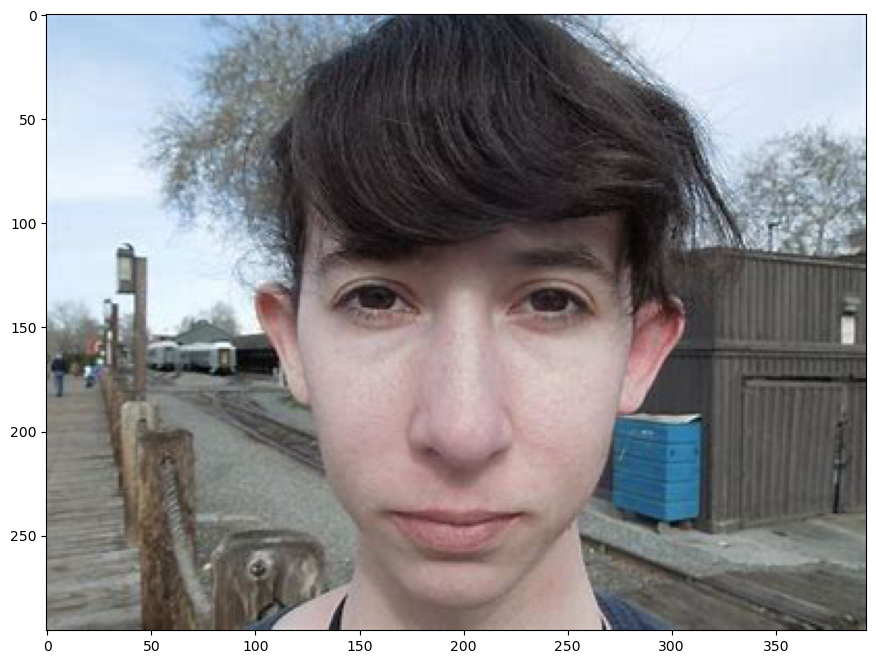

Predicted as: Female


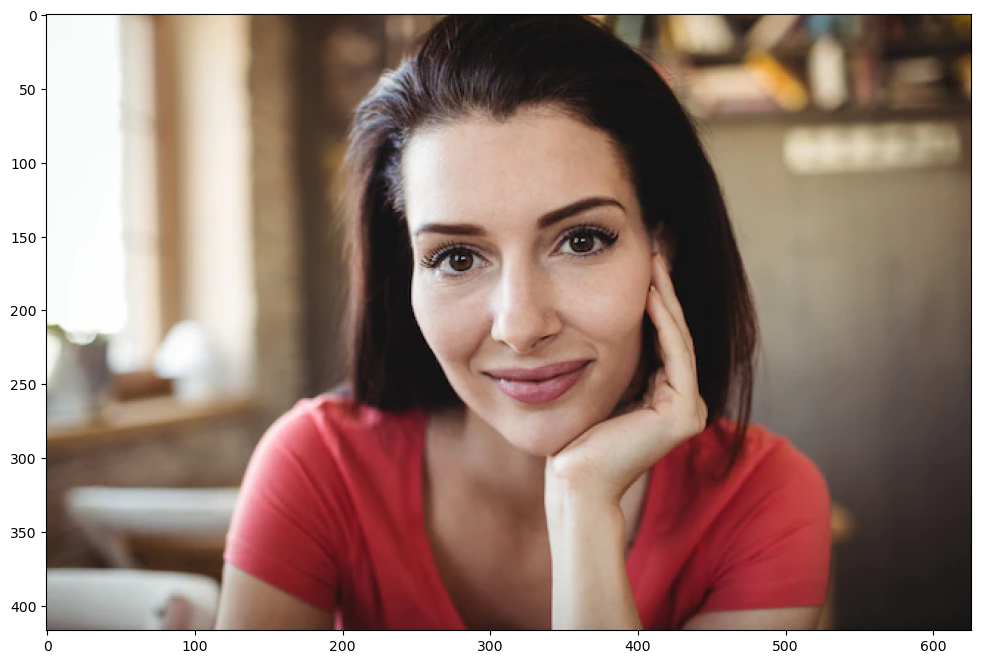

Predicted as: Male


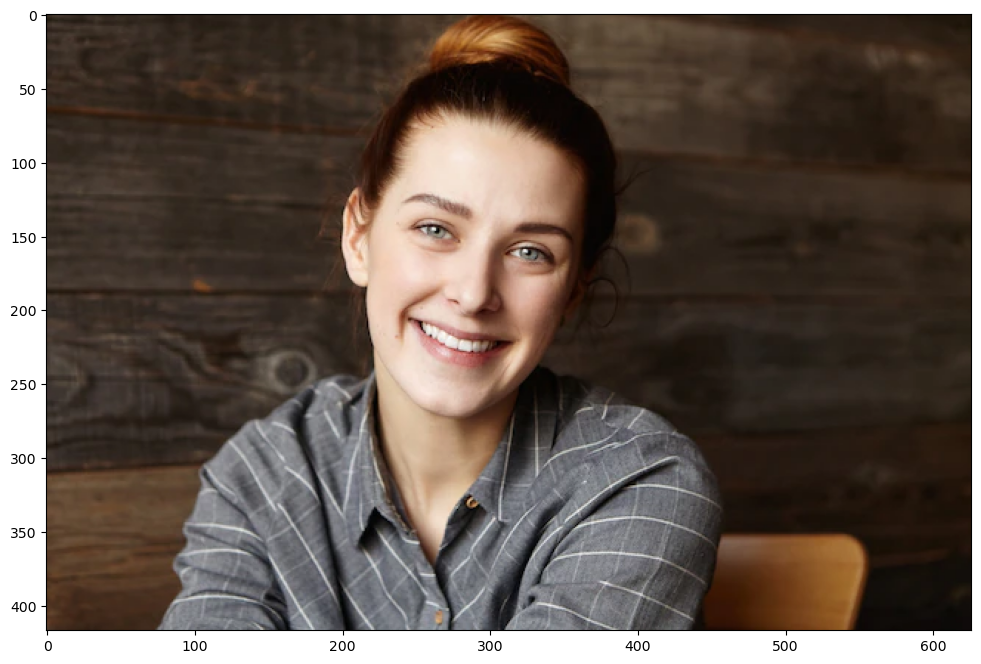

Predicted as: Female


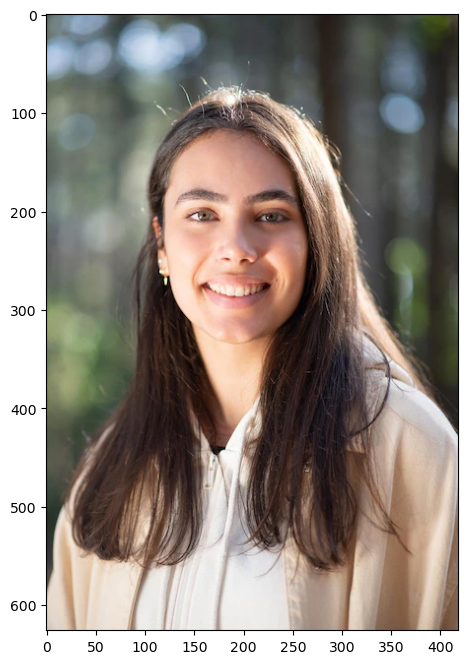

Predicted as: Male



Model Accuracy: 75.0 %


In [30]:
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

correct = 0
error = []

for filename in glob.glob('online/class0/*.jpg'):
    im=Image.open(filename)
    plt.imshow(im)
    plt.show()
    im = im.convert('L')
    im = im.resize((w,h))
    im = np.array(im)
    # reshape to be [samples][channels][width][height]
    im = im.reshape(1, w, h, 1).astype('float32')
    # Normalize the data
    im = im /255
    predict_x = final_model.predict_classes(im) 
    if predict_x == 0:
        print("Predicted as: Male")
        correct += 1
    else:
        print("Predicted as: Female")
        error.append(filename)

for filename in glob.glob('online/class1/*.jpg'):
    im=Image.open(filename)
    plt.imshow(im)
    plt.show()
    im = im.convert('L')
    im = im.resize((w,h))
    im = np.array(im)
    # reshape to be [samples][channels][width][height]
    im = im.reshape(1, w, h, 1).astype('float32')
    # Normalize the data
    im = im /255
    predict_x = final_model.predict_classes(im) 
    if predict_x == 0:
        print("Predicted as: Male")
        error.append(filename)
    else:
        print("Predicted as: Female")
        correct += 1
        
print("\n\n\nModel Accuracy:", (correct/20) * 100, "%")

##### Discussion on the error prediction images

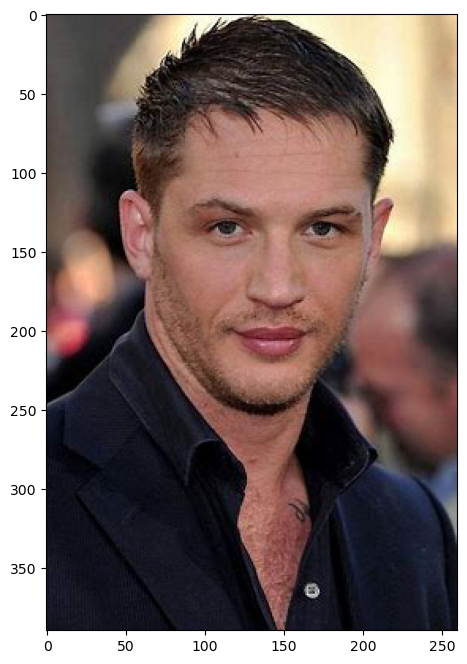

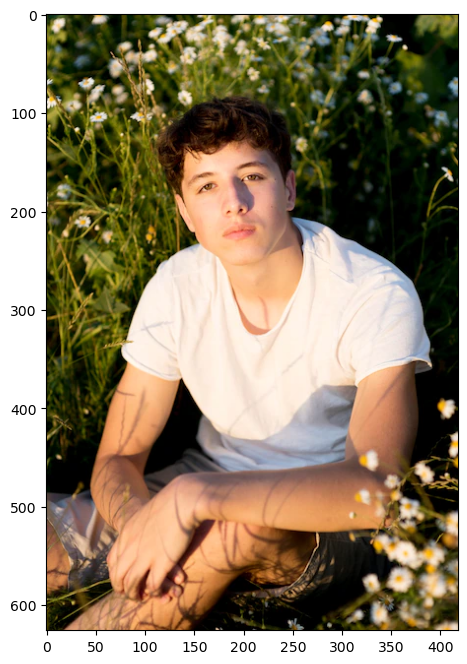

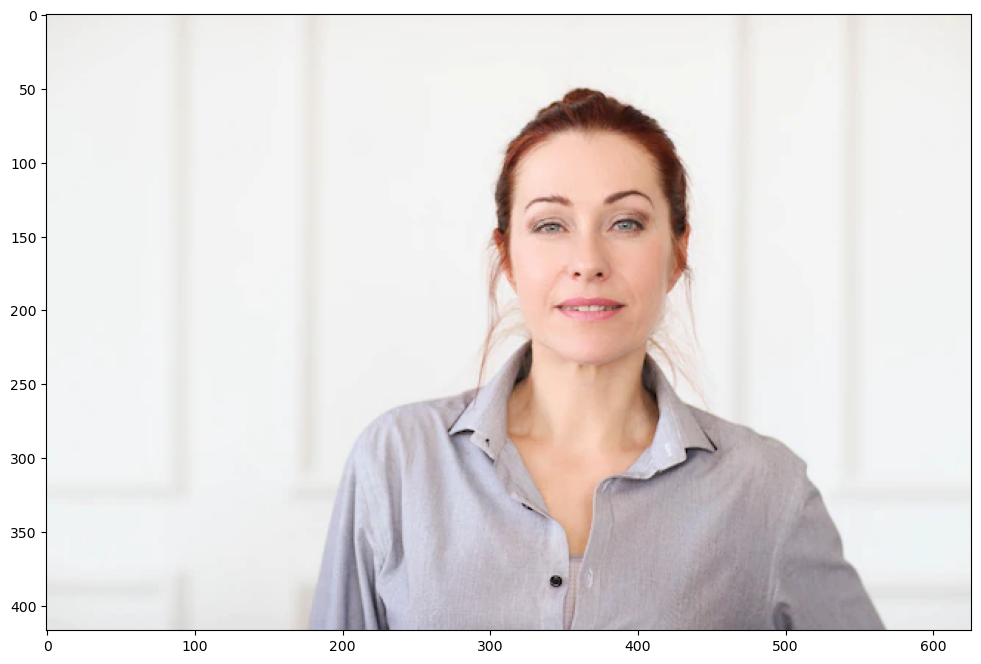

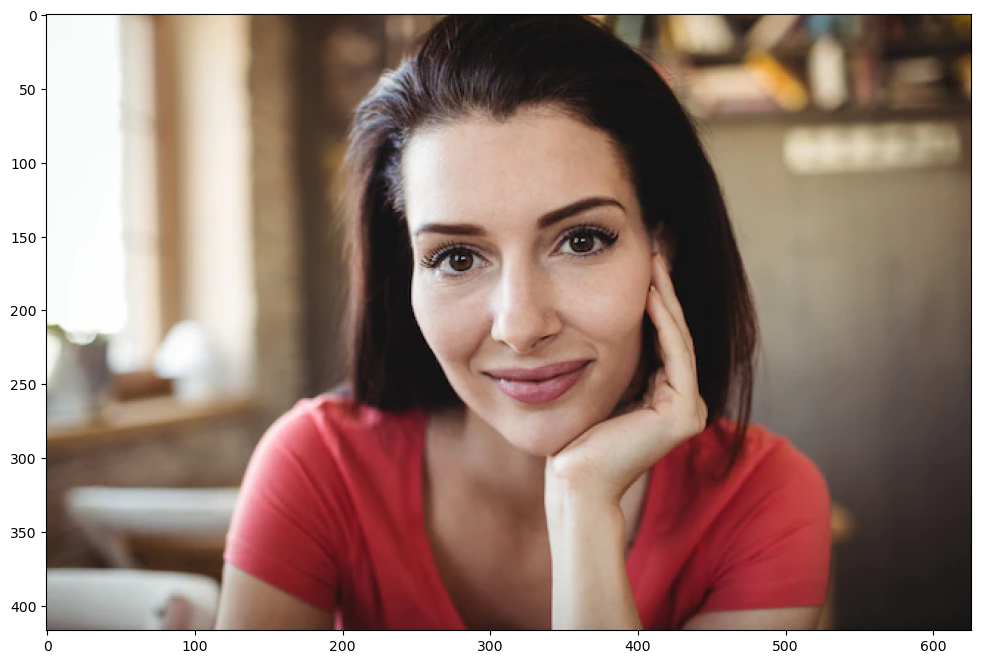

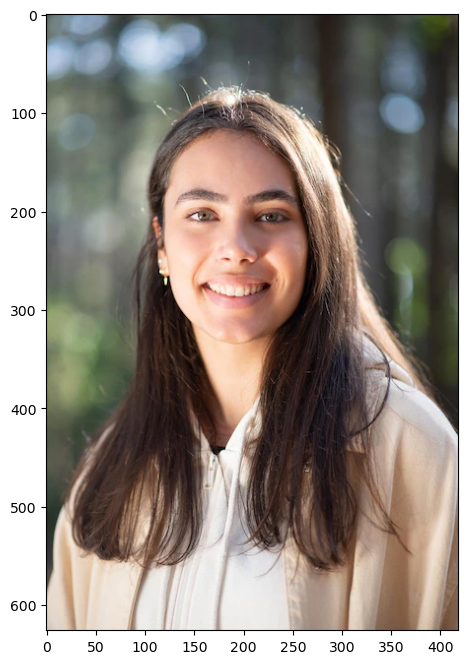

In [31]:
for filename in error:
    im=Image.open(filename)
    plt.imshow(im)
    plt.show()
   

The images shown above are predict wrong in the gender.

<span style = color:red>Male</span>

For the first 2 images, it should be Male but its predict as female. This might because the eyes and lips is more likely look like female. They both got very bright lips color and calm eyes.

<span style = color:red>Female</span>

The last 3 images should be Female. The first 2 images for female were predict wrong might because of the hair look like man. Besides that, on the second image the hand shown in the image might effect the prediction as well. The last female maybe due to the eyebrow which is thick and the skin color is a bit darker. 

#### Saliency Maps

In [83]:
def plot_gradcam_plusplus_of_a_model(model, Xt, image_titles, class_values):
    score = CategoricalScore(class_values)
    # Create GradCAM++ visualization object
    gradcam = GradcamPlusPlus(model,
                          model_modifier=ReplaceToLinear(),
                          clone=True)
    # Generate heatmap with GradCAM++
    cam = gradcam(score,
                  Xt,
                  penultimate_layer=-1)

    # Plot
    f, ax = plt.subplots(nrows=1, ncols=10, figsize=(20, 14))
    for i, title in enumerate(image_titles):
        heatmap = np.uint8(cm.jet(cam[i])[..., :3] * 255)
        ax[i].set_title(title, fontsize=16)
        ax[i].imshow(Xraw[i], cmap="gray")
        ax[i].imshow(heatmap, cmap='jet', alpha=0.5)
        ax[i].axis('off')
       
    plt.tight_layout()
    plt.show()

In [84]:
def plot_vanilla_saliency_of_a_model(model, X, image_titles, class_values):

    score = CategoricalScore(class_values)

    # Create Saliency visualization object
    saliency = Saliency(model,
                        model_modifier=ReplaceToLinear(), # replaces the activation function of the chosen layer (here is the last layer) to linear function (for visualization)
                        clone=True)

    # Generate saliency map
    saliency_map = saliency(score, X)

    # Plot
    f, ax = plt.subplots(nrows=1, ncols=10, figsize=(12, 4))
    for i, title in enumerate(image_titles):
        ax[i].set_title(title, fontsize=16)
        ax[i].imshow(saliency_map[i], cmap='jet')
        ax[i].axis('off')
    plt.tight_layout()
    plt.show()

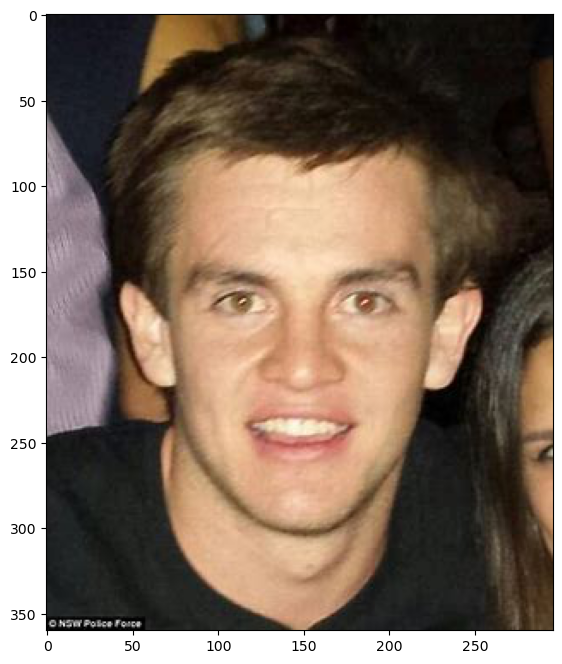

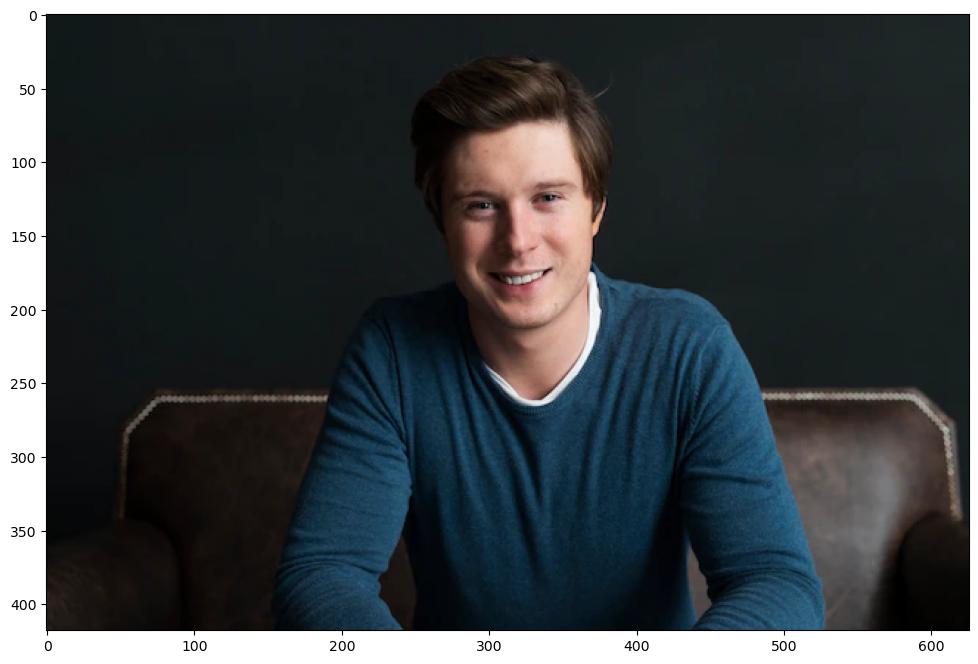

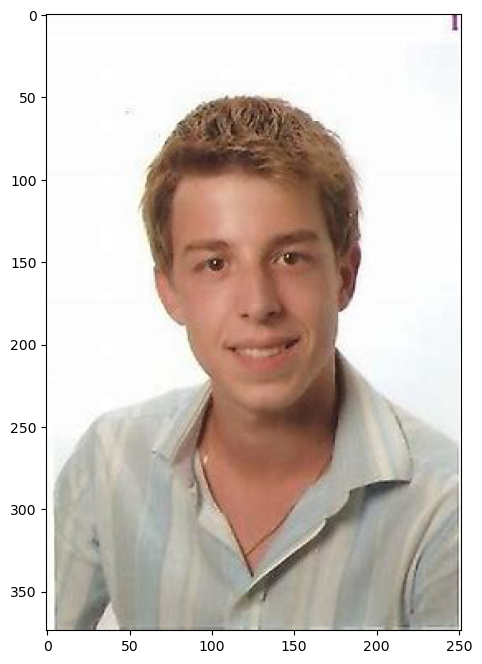

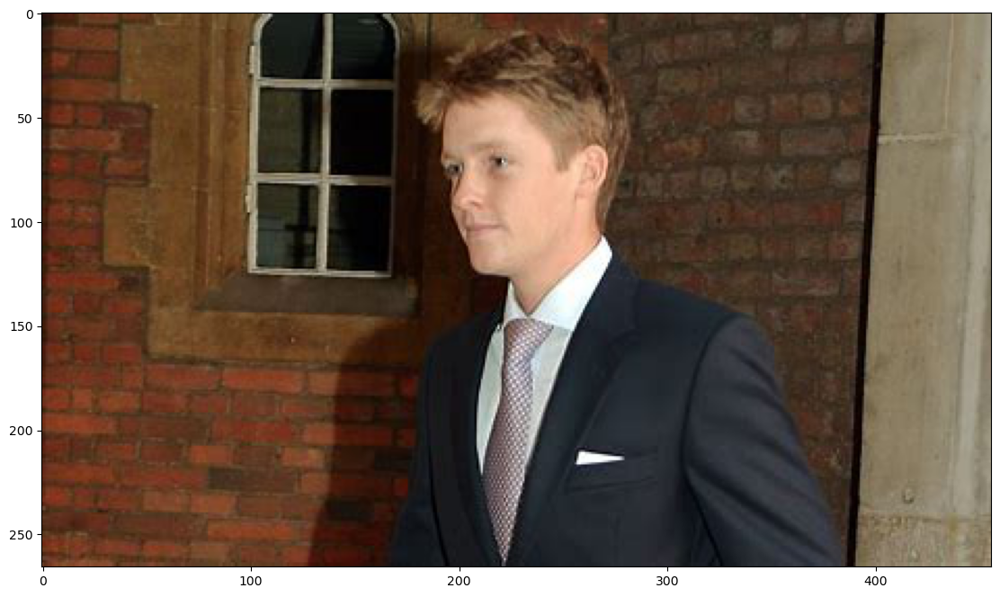

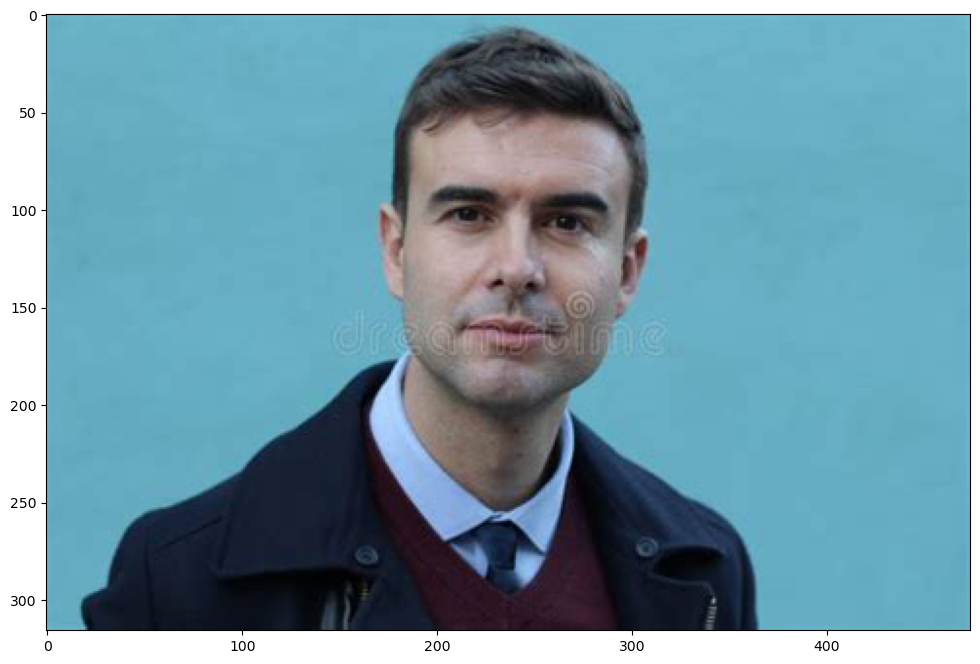

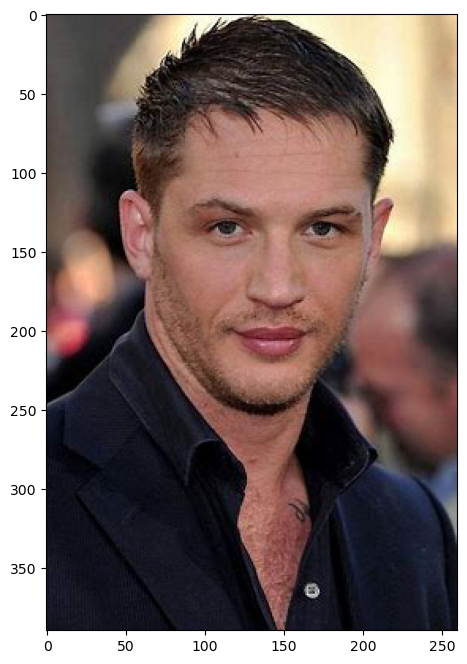

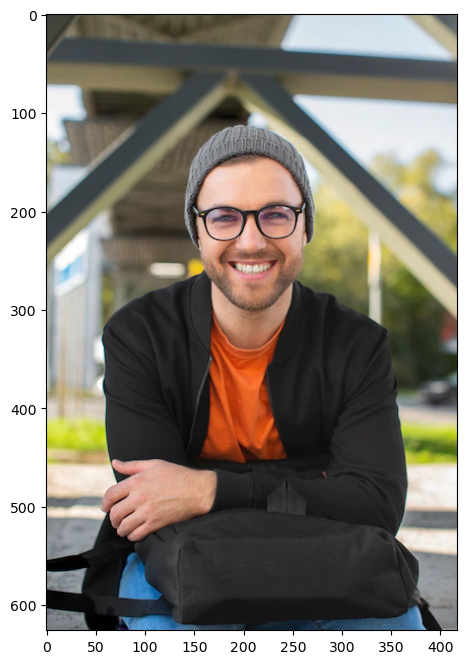

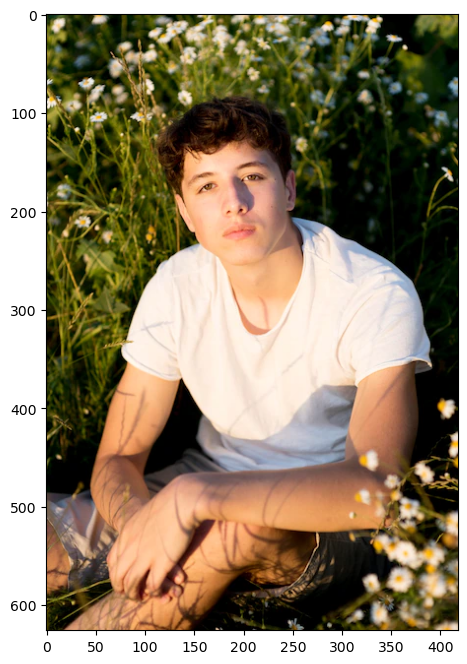

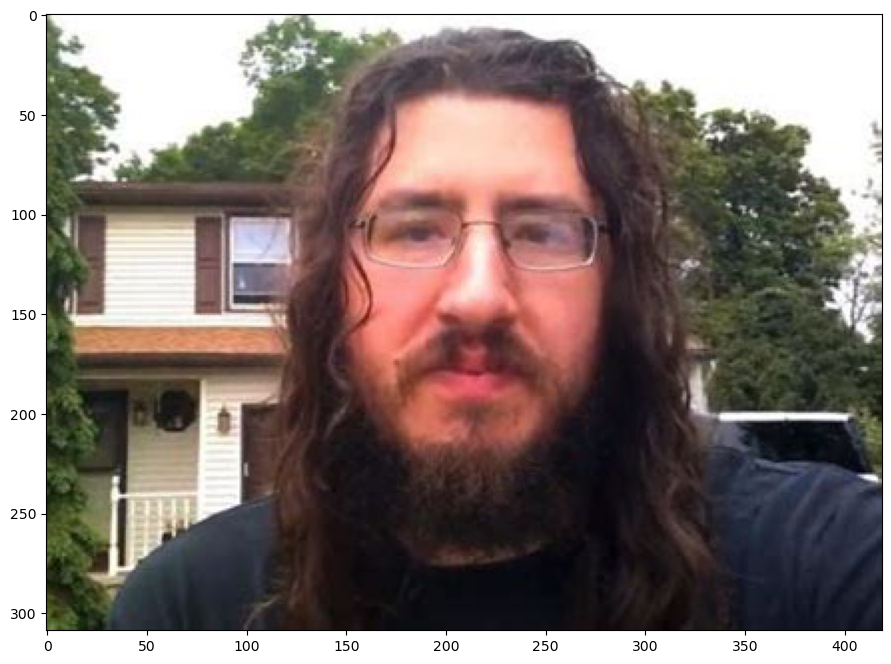

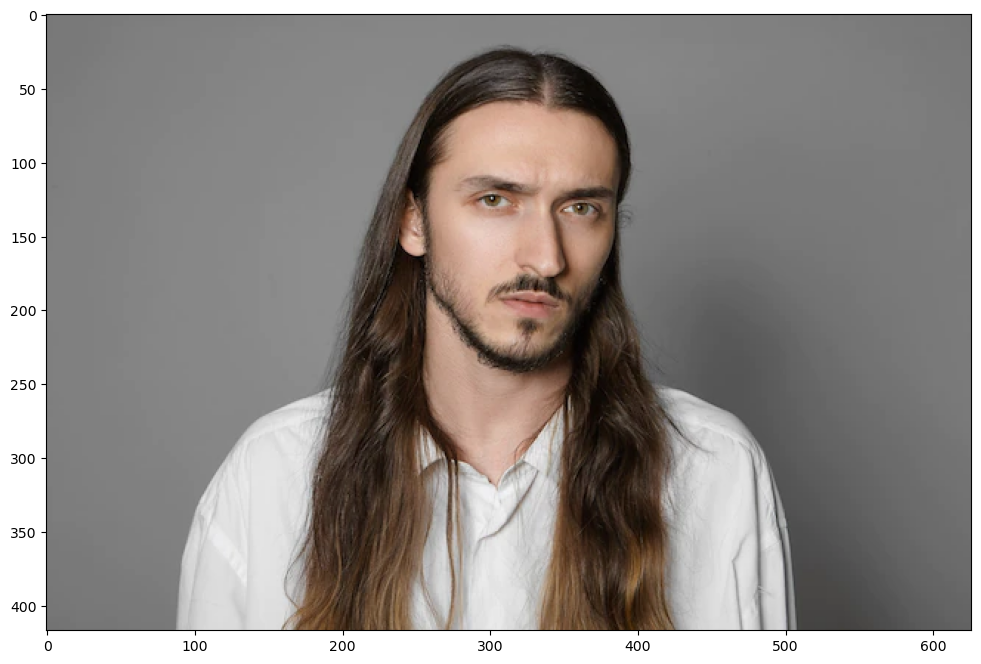

In [89]:
Xt =[]
Xraw = []
image_titles=[]
class_values=[]
counter = 1

for filename in glob.glob('online/class0/*.jpg'):
    im=Image.open(filename)
    plt.imshow(im)
    plt.show()
    im = im.resize((w,h),Image.LANCZOS)
    im = im.convert('L')
    Xraw.append(im)
    
    im = np.array(im)
    # Normalize the data
    im = im /255
    Xt.append(np.array(im))
    name = "Male " + str(counter)
    counter +=1
    image_titles.append(name)
    class_values.append(0)

Xt = np.asarray(Xt)
Xt = Xt.reshape(Xt.shape[0], w, h, 1).astype('float32')

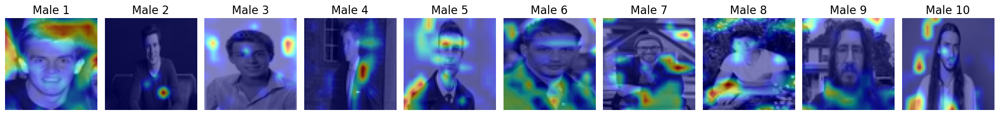

In [90]:
plot_gradcam_plusplus_of_a_model(final_model, Xt, image_titles, class_values)

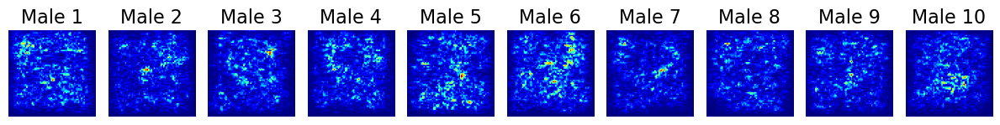

In [91]:
plot_vanilla_saliency_of_a_model(final_model, Xt, image_titles, class_values)

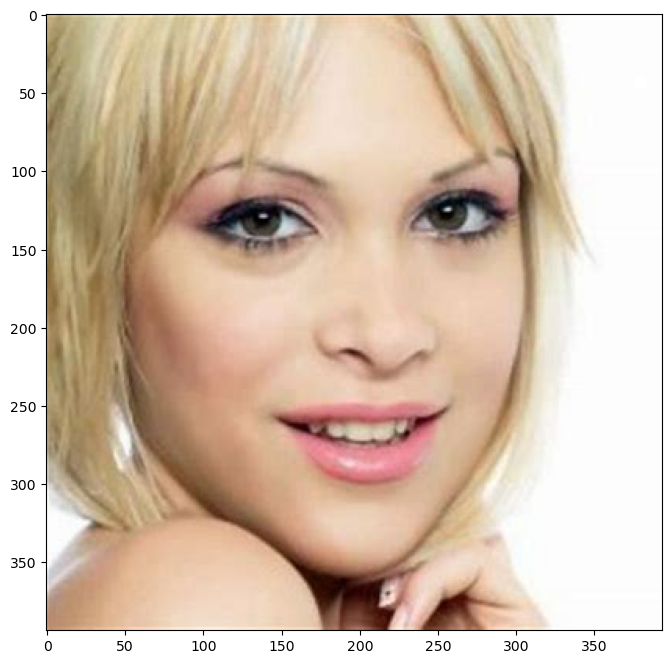

C:\Users\Wan Yit\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:11: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  # This is added back by InteractiveShellApp.init_path()


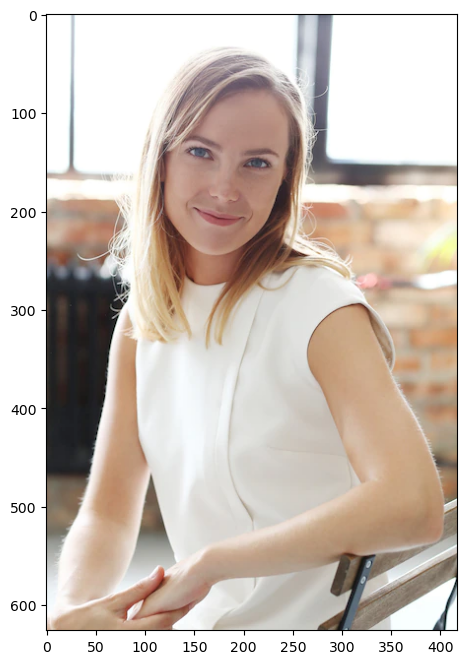

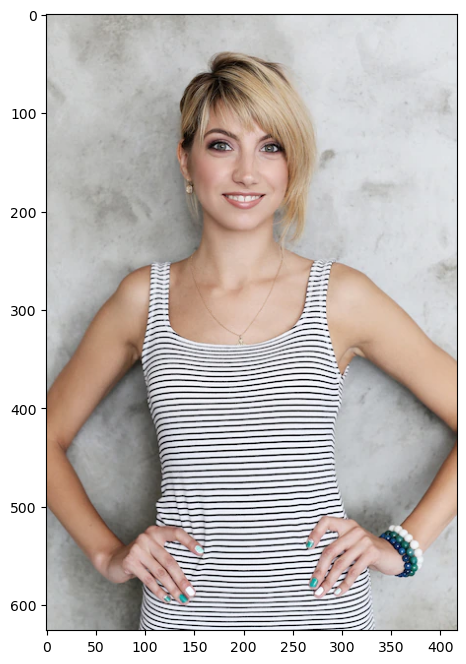

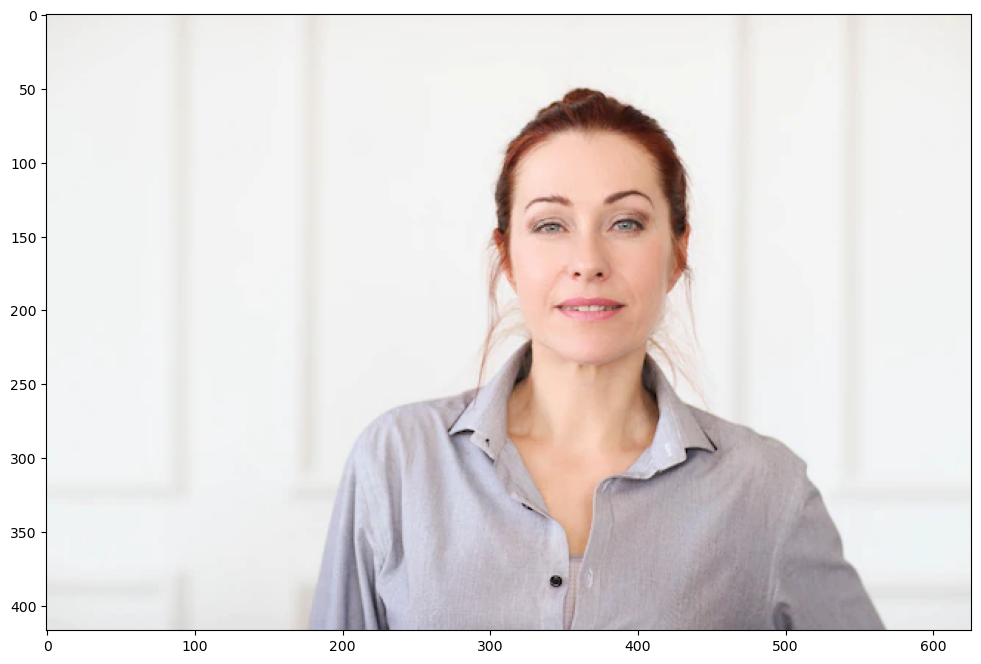

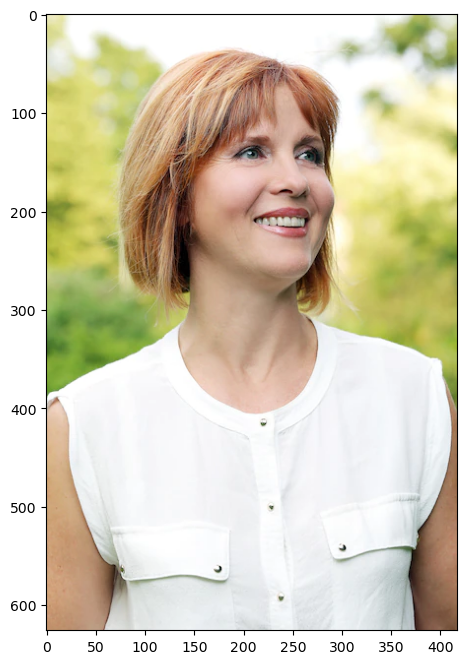

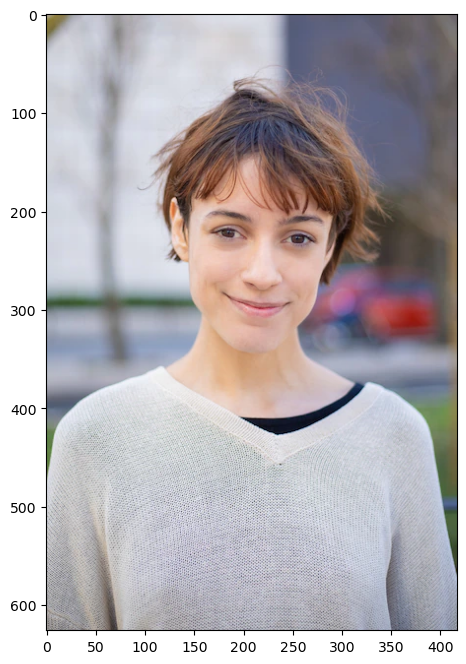

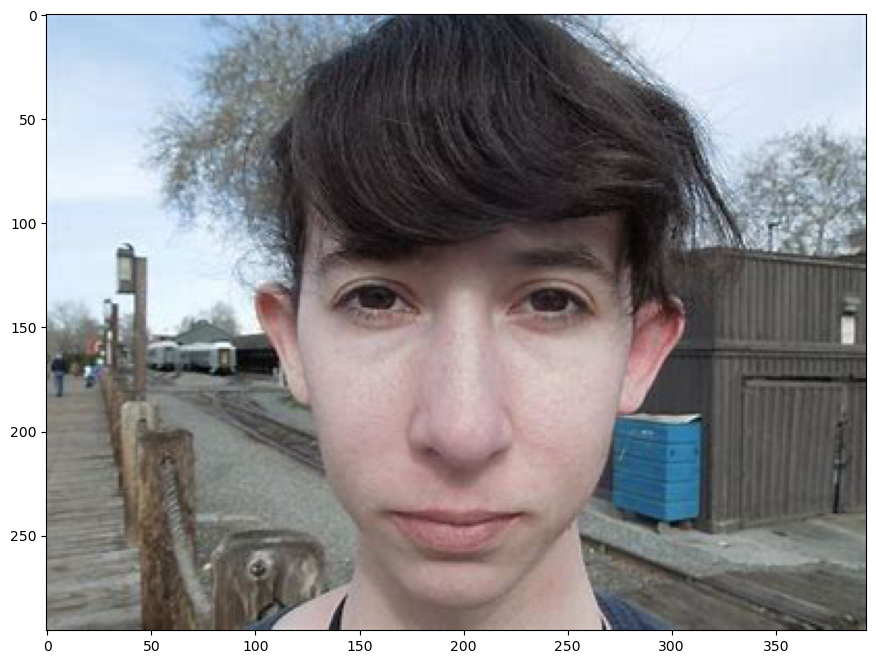

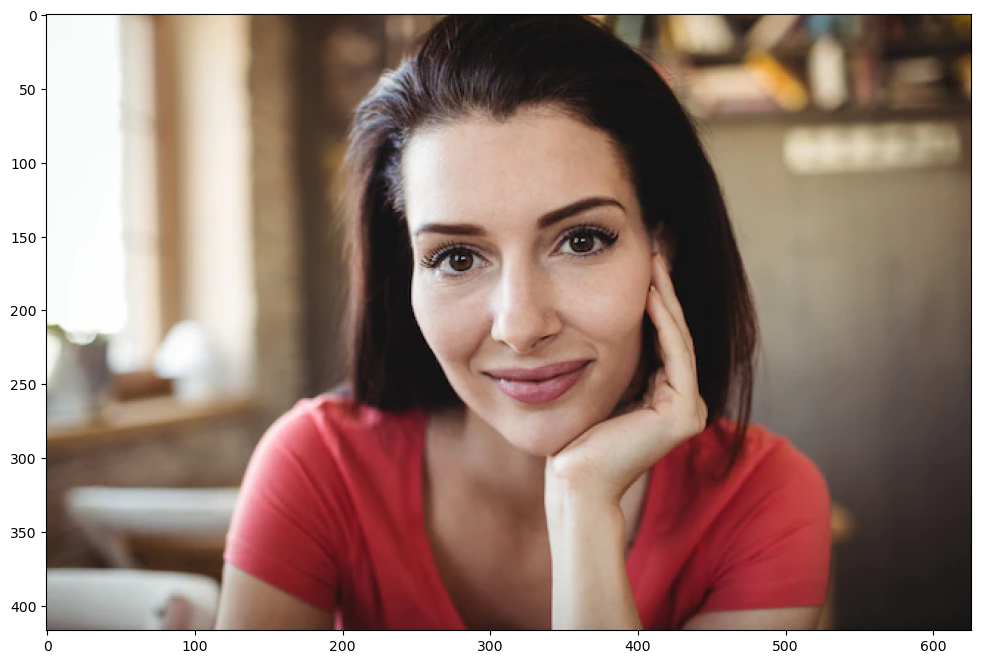

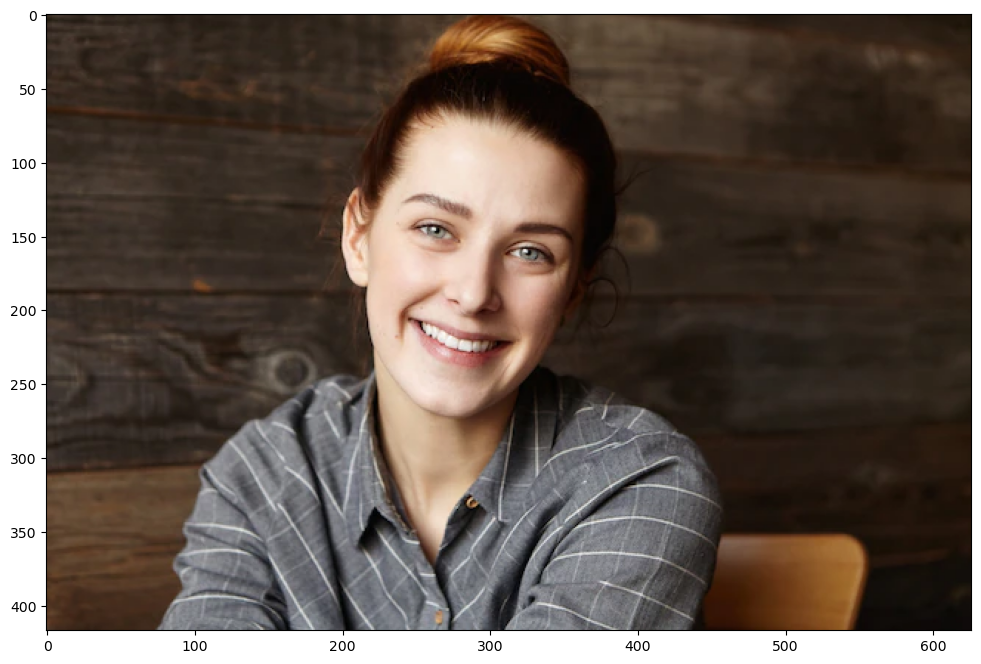

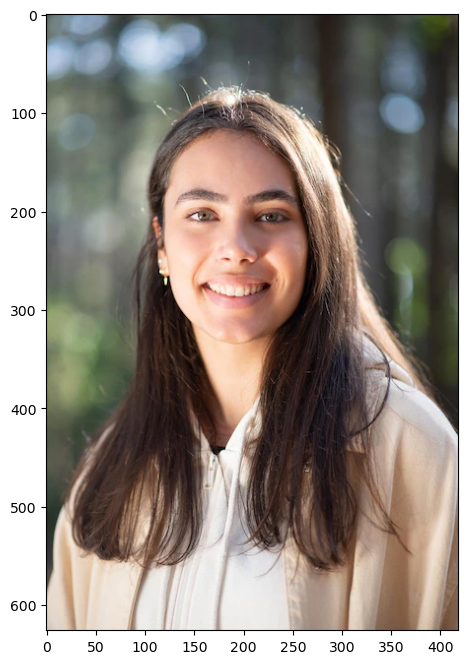

In [93]:
Xt =[]
Xraw = []
image_titles=[]
class_values=[]
counter = 1

for filename in glob.glob('online/class1/*.jpg'):
    im=Image.open(filename)
    plt.imshow(im)
    plt.show()
    im = im.resize((w,h),Image.ANTIALIAS)
    im = im.convert('L')
    Xraw.append(im)
    
    im = np.array(im)
    # Normalize the data
    im = im /255
    Xt.append(np.array(im))
    name = "Female " + str(counter)
    counter +=1
    image_titles.append(name)
    class_values.append(0)

Xt = np.asarray(Xt)

Xt = Xt.reshape(Xt.shape[0], w, h, 1).astype('float32')

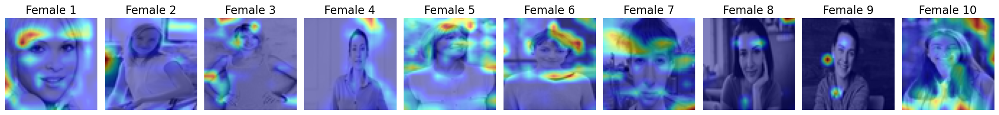

In [94]:
plot_gradcam_plusplus_of_a_model(final_model, Xt, image_titles, class_values)

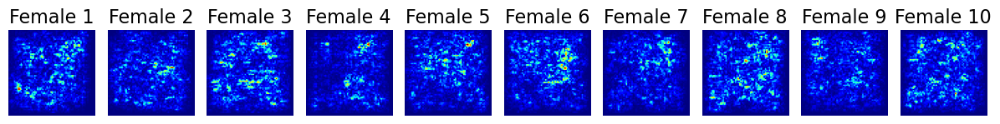

In [95]:
plot_vanilla_saliency_of_a_model(final_model, Xt, image_titles, class_values)

### Analysis of performance for the target group

In [1]:
# definition to provide the metrics
def subMetrics(targetGroup, act, pred):
  print("Metrics for: ", targetGroup)
  correct = 0
  # parse both lists to numpy arrays
  act = np.array(act)
  pred = np.array(pred)
  # There may be an easier way to do this, however, I believe it is a manual process!
  for index, item in enumerate(act):  
    if item == pred[index]:
      correct += 1
  # print accuracy, and the confusion matrix
  accuracy = round((correct / len(act)) * 100,2) 
  print("Accuracy:", accuracy, "%")
  print(pd.crosstab( np.array(act),  np.array(pred), rownames=['Actual'], colnames=['Predicted'], margins=True))

In [49]:
w = 64
h = 64

# fix random seed for reproducibility
seed = 1
np.random.seed(seed)
tf.random.set_seed(seed)

rawImages = []
instances = []
img = []
Y_test = []

for filename in glob.glob('online/class0/*.jpg'):
    im=Image.open(filename)
    rawImages.append(im)
    im = im.convert('L')
    im = im.resize((w,h),Image.ANTIALIAS)
    X = np.array(im)
    # Normalize the data
    X = X /255
    instances.append(X)
    Y_test.append(0)
    img.append(filename)


for filename in glob.glob('online/class1/*.jpg'):
    im=Image.open(filename)
    rawImages.append(im)
    im = im.convert('L')
    im = im.resize((w,h),Image.ANTIALIAS)
    X = np.array(im)
    # Normalize the data
    X = X /255
    instances.append(X)
    Y_test.append(1)
    img.append(filename)

instances = np.array(instances)
instances = instances.reshape(instances.shape[0],w, h, 1).astype('float32')

# Predict for target group.
tar_pred = final_model.predict_classes(instances)

df_tar = pd.DataFrame()
df_tar['image'], df_tar['gender'] = img, Y_test
df_tar

C:\Users\Wan Yit\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:18: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
C:\Users\Wan Yit\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:31: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.


,image,gender
0,online/class0\0_0_1.jpg,0
1,online/class0\0_0_10.jpg,0
2,online/class0\0_0_2.jpg,0
3,online/class0\0_0_3.jpg,0
4,online/class0\0_0_5.jpg,0
5,online/class0\0_0_6.jpg,0
6,online/class0\0_0_8.jpg,0
7,online/class0\0_0_9.jpg,0
8,online/class0\0_1_4.jpg,0
9,online/class0\0_1_7.jpg,0


In [50]:
# Example for sex target groups  
female_pred = []      # Female was label encoded as 0
female_actual_class = []

male_pred = []        # Male was label encoded as 1
male_actual_class = []

df_tar = df_tar.reset_index()

for index,row in df_tar.iterrows():
    if row[2] == 1:       # Female
        female_pred.append(tar_pred[index])
        female_actual_class.append(Y_test[index])
    elif row[2] == 0:     # Male
        male_pred.append(tar_pred[index])
        male_actual_class.append(Y_test[index])

# Print the representation of each target group       
print("Female instances in the test set:", len(female_pred))        
print("Male instances in the test set:  ", len(male_pred)) 


print("\n"*2)
# Confusion Matrix:
# overall TP, FP, TN, FN values, for binary values only
subMetrics("Female", female_actual_class, female_pred)
print("\n")
subMetrics("Male", male_actual_class, male_pred)

Female instances in the test set: 10
Male instances in the test set:   10



Metrics for:  Female
Accuracy: 70.0 %
Predicted  0  1  All
Actual              
1          3  7   10
All        3  7   10


Metrics for:  Male
Accuracy: 80.0 %
Predicted  0  1  All
Actual              
0          8  2   10
All        8  2   10


From the metric above, we able to notice that the male prediction is slightly higher than Female. Even though the model was trained with fairly equals betweeen both gender (Male & Female) with 1600 images each, the male has higher prediction. This might because of male have more specific features to identity such as whiskers, mostly short hair, etc. and female characteristics are sharing with male.

### Development of a cloud-hosted production model and testing on unseen data (10 per class)

In [51]:
import time
ts = int(time.time())
file_path = f"C:\production\{ts}"
final_model.save(filepath=file_path, save_format='tf')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: C:\production\1689155560\assets


In [52]:
url = 'http://20.237.12.217:8501/v1/models/img_classifier:predict'
# url = 'http://localhost:8501/v1/models/img_classifier:predict'

def make_prediction(instances):
    data = json.dumps({"signature_name": "serving_default", "instances": instances.tolist()})
    headers = {"content-type": "application/json"}
    json_response = requests.post(url, data=data, headers=headers)
    predictions = json.loads(json_response.text)["predictions"]
    return predictions

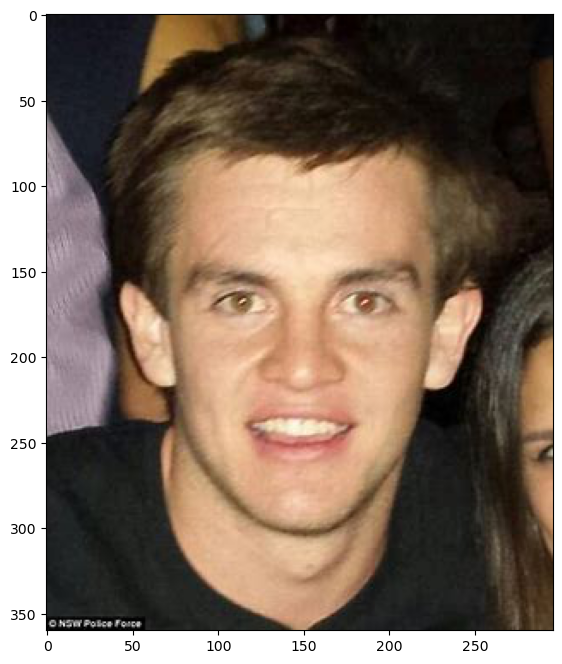

Predict as: Male


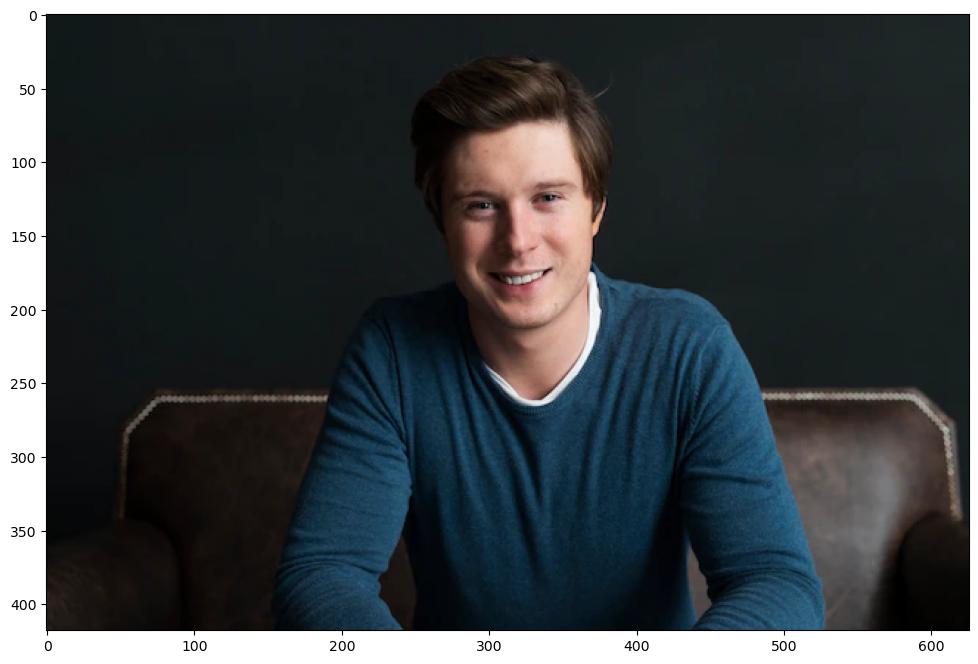

Predict as: Male


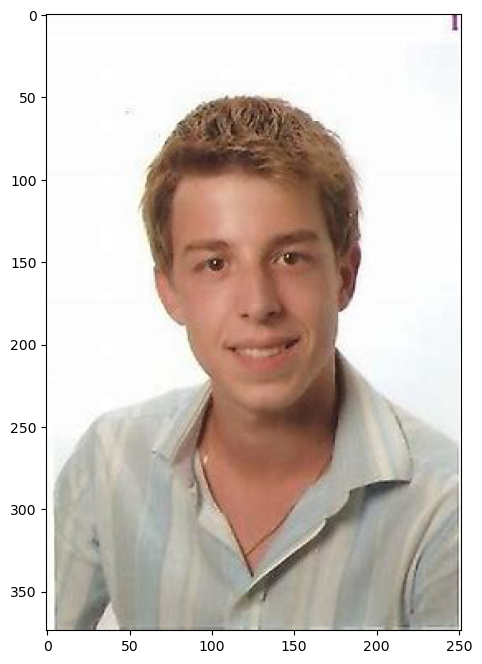

Predict as: Male


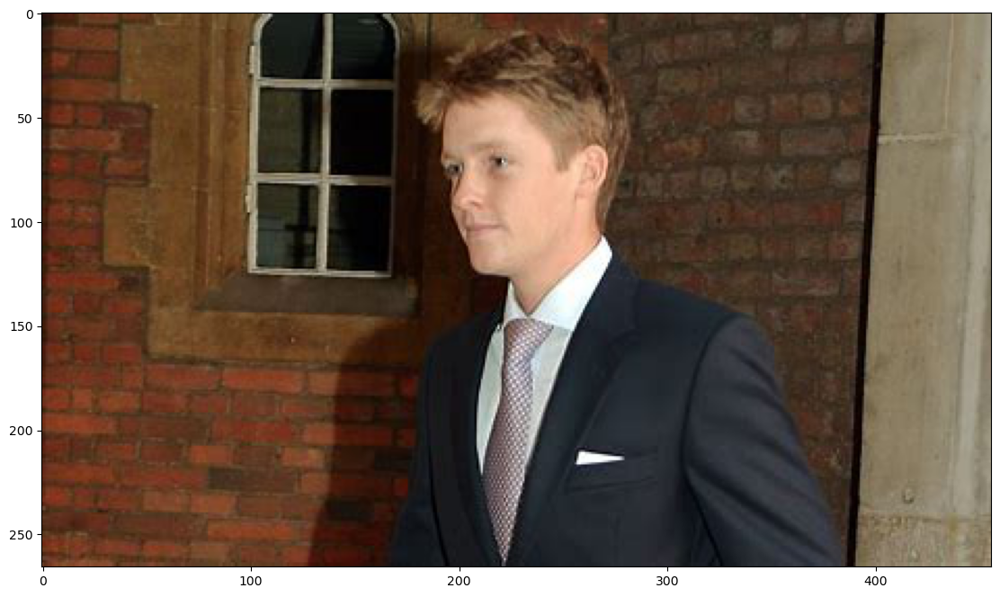

Predict as: Male


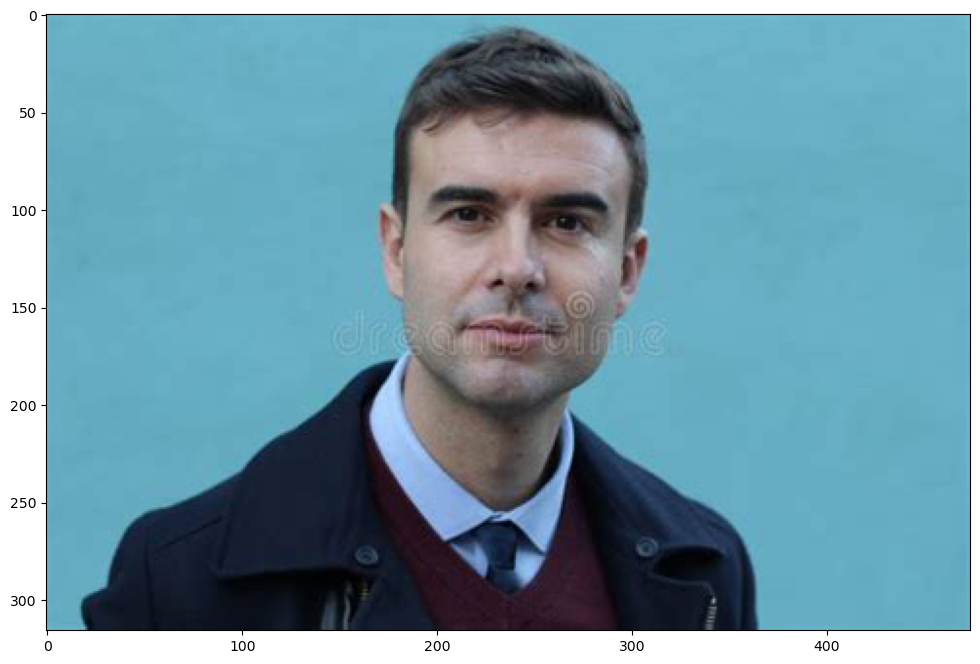

Predict as: Male


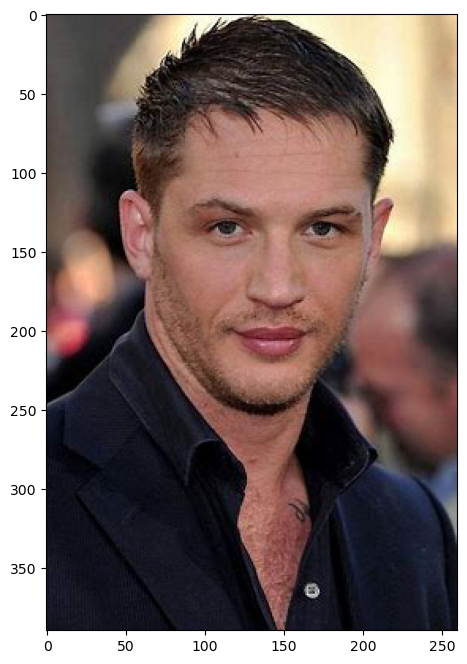

Predict as: Female


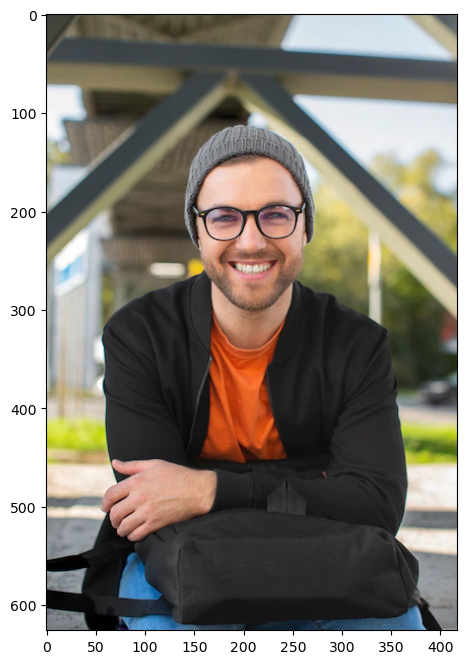

Predict as: Male


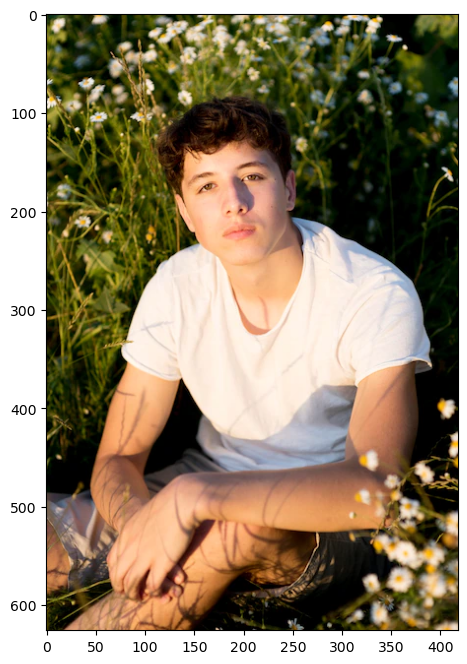

Predict as: Female


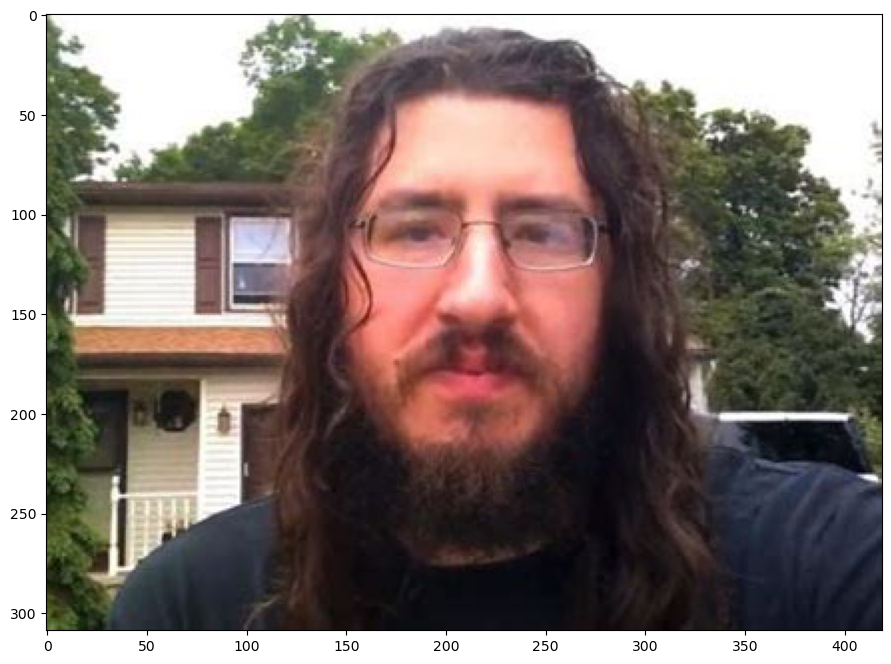

Predict as: Male


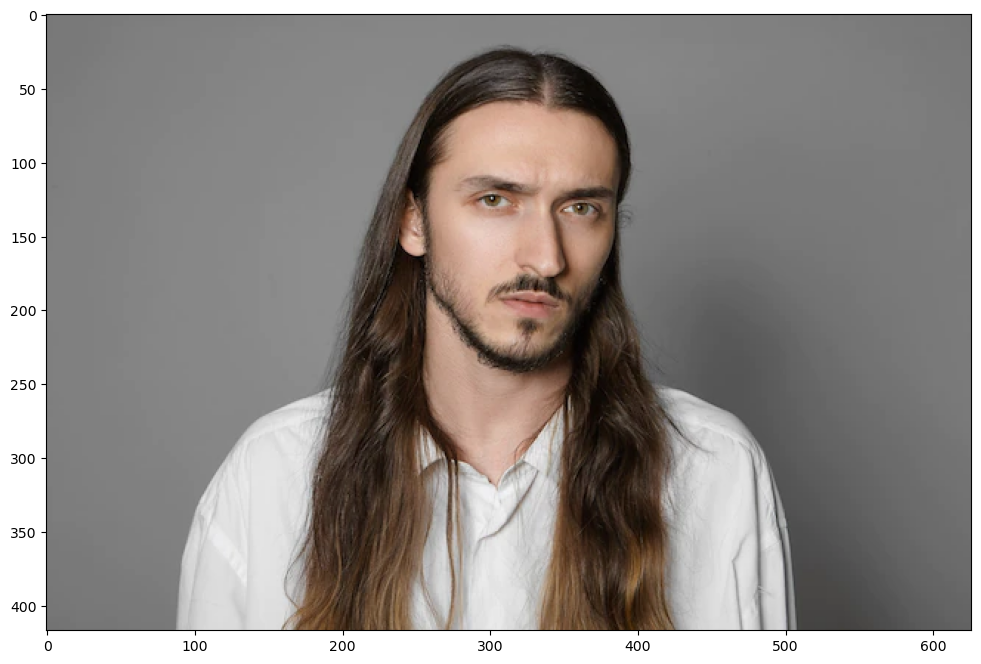

Predict as: Male


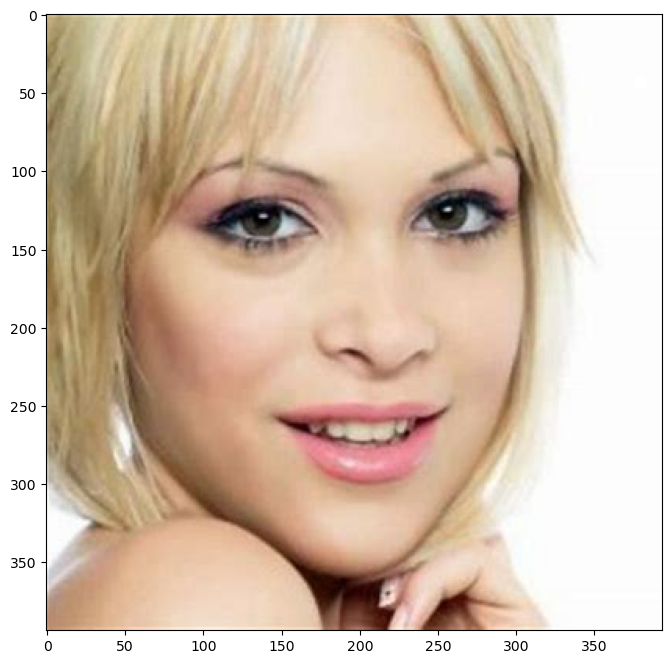

Predict as: Female


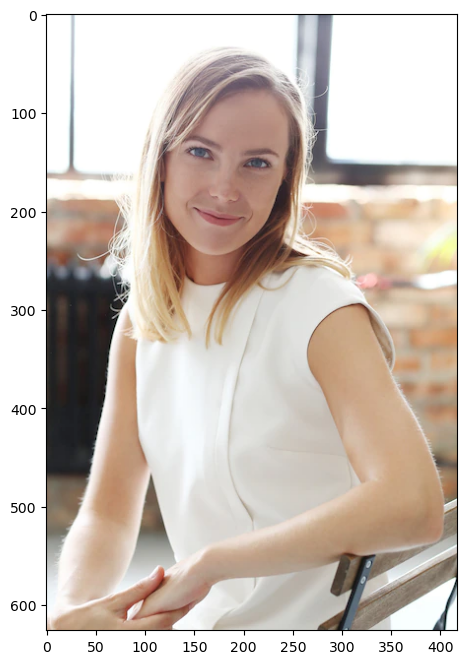

Predict as: Female


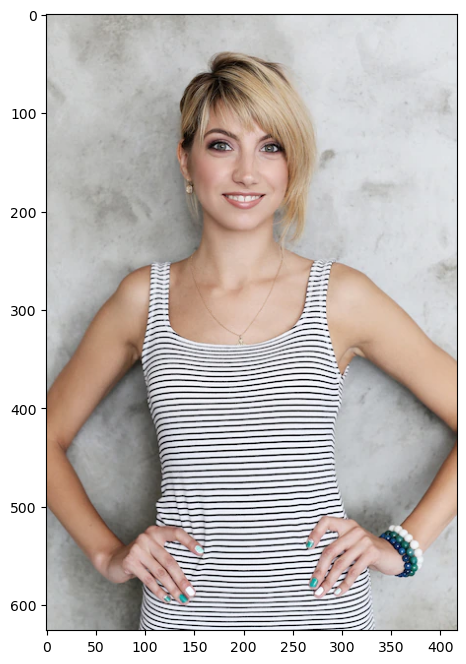

Predict as: Female


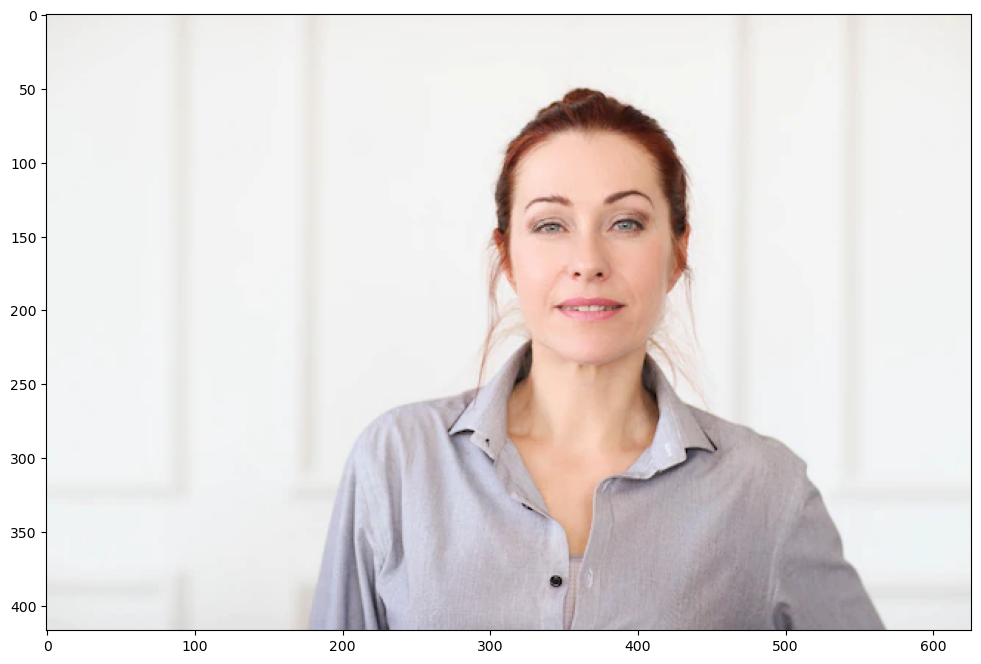

Predict as: Male


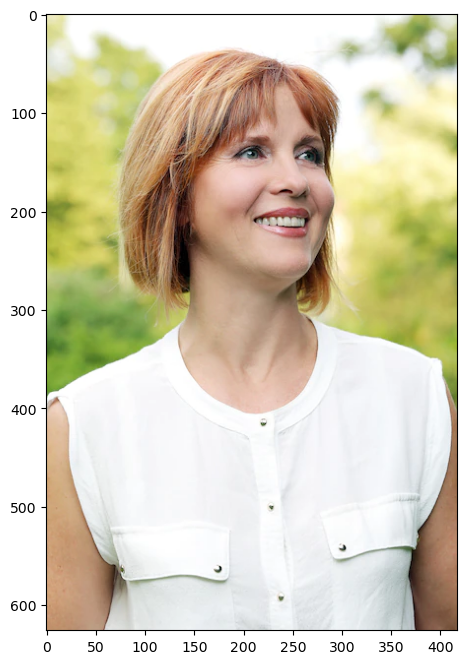

Predict as: Female


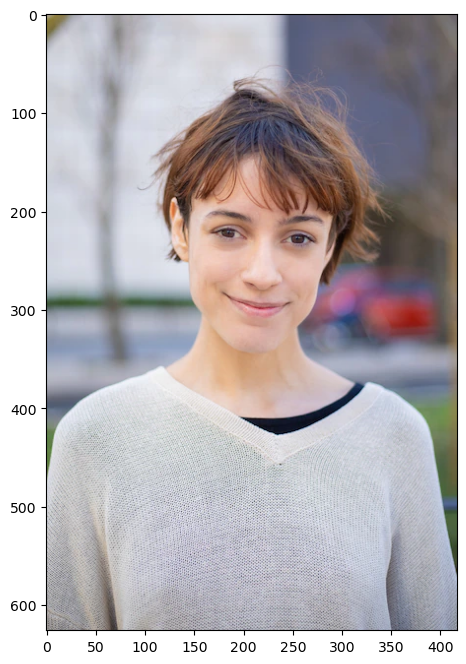

Predict as: Female


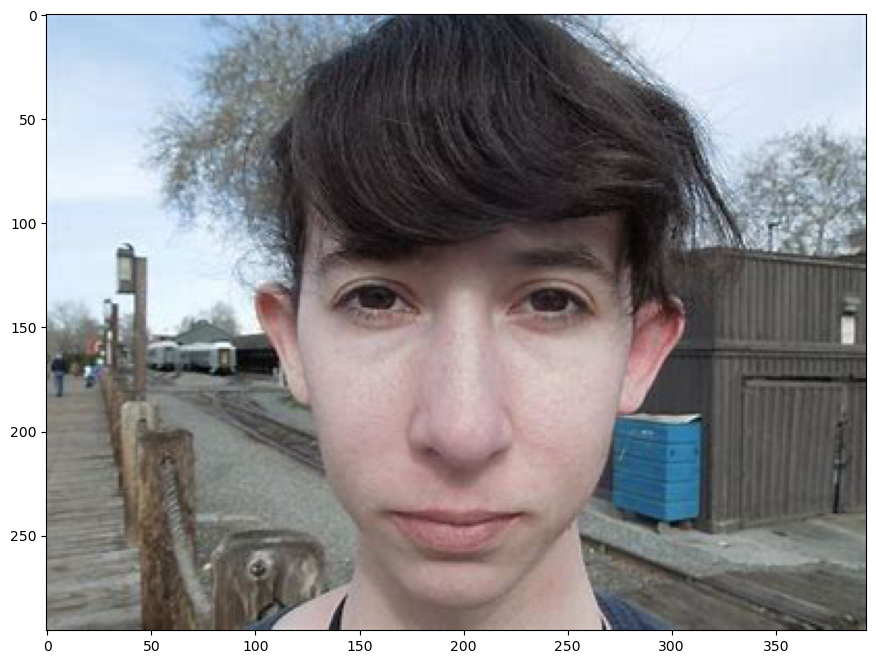

Predict as: Female


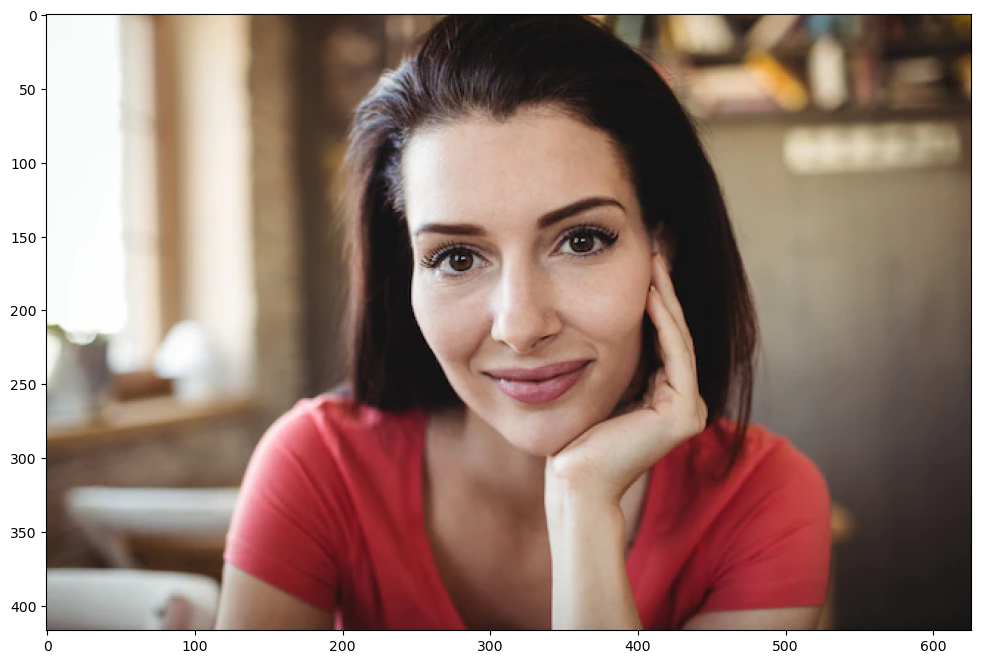

Predict as: Male


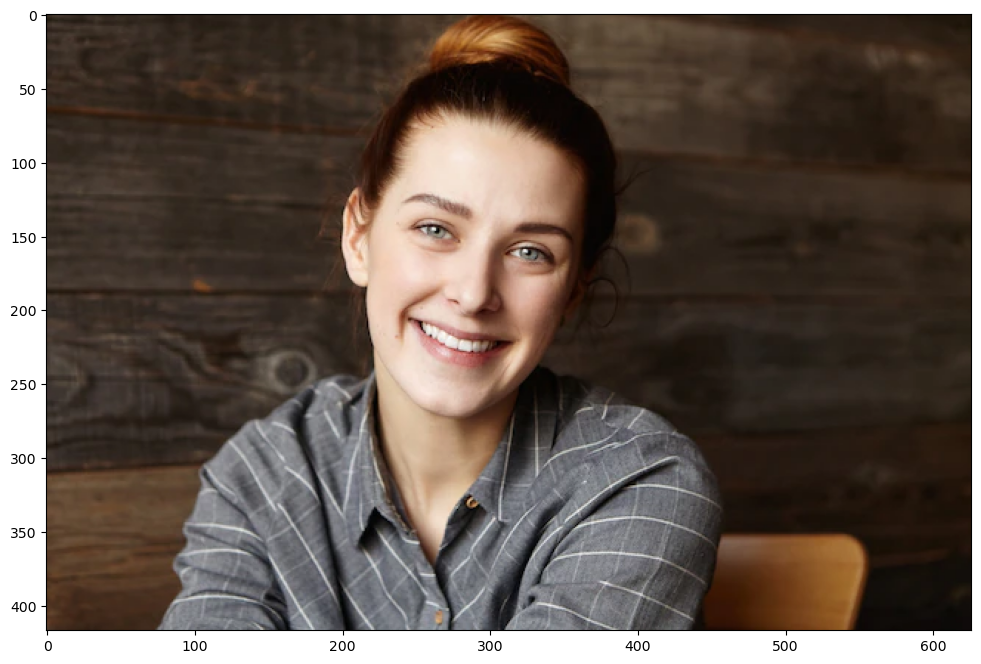

Predict as: Female


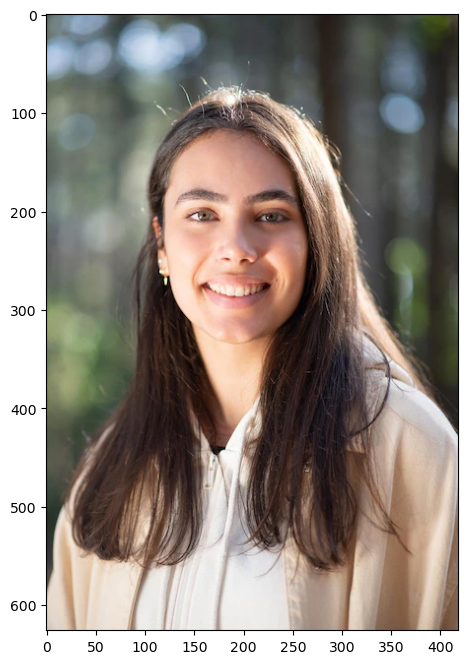

Predict as: Male


In [53]:
import requests
import json

predictions = make_prediction(instances)

for i, pred in enumerate(predictions):
    imgplot = plt.imshow(rawImages[i])
    plt.show()
    if np.argmax(pred) == 0:
        print("Predict as: Male")
    else:
        print("Predict as: Female")

### Summary and Conclusion

In this project, we have develop a deep learning model for image classification with the 'UTK Face' dataset. The dataset consists of human face from different race, ages, and gender, and our goal was to buila a model capable of accurately predicting the gender for age from 25 to 35 associated with the images.  We performed data exploration, preprocessing, and implemented batch processing with image augmentation to enhance the model's performance.

Futhermore, we successfully deployed the model by creating a Docker image and create the container on Azure portal service for efficient and scalable deployment. 

We trained multiple network models with different architectures, leveraging convolutional and dense layers. We utilized techniques such as regularization, and hyperparameter tuning (kernel sizes) to improve the model's performance and achieve better generalization. Furthermore, we conducted performance analysis per class, evaluating the model's accuracy and identifying potential biases or challenges specific to certain groups. The result for this project is quite good as we got quite high accuracy for the gender predictions. 

In conclusion, this project has shown the development of a deep learning image classifier using part of the 'UTK Face' dataset. We implemneted state-of-art techniques for data preprocessing, model design, and hyperparameter tuning, resulting in a high-performing model.

Additionally, the deployment of the model to a Docker image and the Azure portal service contatiner allowed for efficient further usage. The use of Docker image allowed the model we create has a guaranteeing consitent results regardless of the deployment environement. By using Azure portal service, it provides the easy access of the model we created on different platform, multiple user accressing within the Azure ecosystem.

By combining deep learning expertise with the deployment techniques, such as Docker and Azure portal service, we can effeticely develop and deploy models that able to meet high standards of performance, and transparency.